In [ ]:
# early_stopping

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5)

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,  # Adjust as needed
    validation_data=val_generator,
    validation_steps=val_generator.samples // val_generator.batch_size,
    callbacks=[early_stopping]
)

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
## erick prediction

from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg19 import preprocess_input
import numpy as np

def load_and_prepare_image(image_path):
    img = image.load_img(image_path, target_size=(128, 128))
    img_array = image.img_to_array(img)
    # Rescale the image
    img_array /= 255.0
    img_array_expanded = np.expand_dims(img_array, axis=0)
    return preprocess_input(img_array_expanded)


def predict_image(model, image_path):
    processed_image = load_and_prepare_image(image_path)
    predictions = model.predict(processed_image)
    return predictions

def get_prediction_percentage(predictions):
    class_labels = ['asian', 'black', 'indian', 'white'] # Ensure labels are ordered correctly as per your model's training
    percentages = predictions[0] * 100  # Convert probabilities to percentages
    confidence_dict = {label: float(conf) for label, conf in zip(class_labels, percentages)}
    return confidence_dict

def get_prediction_label(predictions):
    class_labels = ['asian', 'black', 'indian', 'white']  # Adjust based on how your folders are labeled and the order of classes
    predicted_class = class_labels[np.argmax(predictions)]
    return predicted_class


image_path = images_folder_path + '/img_dataset_eth' + '/test/asian/10.jpg'  # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

In [ ]:
################################################################################################################################

In [ ]:
## uploading and loading the files and datasets

In [ ]:
from google.colab import files
upload = files.upload()

Saving utkface_train.zip to utkface_train.zip


In [ ]:
import zipfile
import os

# Specify the name of the uploaded zip file
zip_file_name = "utkface_train.zip"

# Extract the contents of the zip file
with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
    zip_ref.extractall("utkface_dataset")

In [ ]:
from google.colab import files
upload = files.upload()

Saving specific_dataset.zip to specific_dataset.zip


In [ ]:
import zipfile
import os

# Specify the name of the uploaded zip file
zip_file_name = "specific_dataset.zip"

# Extract the contents of the zip file
with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
    zip_ref.extractall("test_dataset")

In [ ]:
## in 'cnn models+utkface+ourdataset+CHG' i determined the cropted images and there wasn't any.

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow.keras.layers as L
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import random
from PIL import Image
import torch

In [ ]:
## splitting to the train and validation

In [ ]:
!pip install split-folders

In [ ]:
import splitfolders

# The dataset directory
input_folder = '/content/utkface_dataset/utkface_train'
# splitted dataset directory
output = 'splitted_dataset'

# Split with a ratio of 80-20 train and validation
splitfolders.ratio(input_folder, output=output, seed=42, ratio=(.8, .2))

Copying files: 13207 files [00:02, 4583.02 files/s]


In [ ]:
## previously in VGG16 the number of images in each category was counted

# **VGG 19**

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG19
from tensorflow.keras import layers, models, optimizers
from tensorflow.keras.optimizers import Adam

In [ ]:
# batch= 32, epoch= 10, opt= adam-0.0001

In [ ]:
# Define paths to the dataset directories
train_dir = '/content/splitted_dataset/train'
validation_dir = '/content/splitted_dataset/val'
test_dir = '/content/test_dataset/specific_dataset'


num_classes = 4

# Define image dimensions
img_height, img_width = 128, 128
batch_size = 32

# Create data generators without data augmentation
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

Found 10564 images belonging to 4 classes.
Found 2643 images belonging to 4 classes.


In [ ]:

from tensorflow.keras.applications import VGG19
from tensorflow.keras import models, layers, optimizers

# Load the pre-trained VGG19 model
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

# Freeze the layers of the pre-trained model
for layer in base_model.layers:
    layer.trainable = False

# Create a new model on top of the pre-trained model
model = models.Sequential()
model.add(base_model)
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(4, activation='softmax'))  # Assuming 4 classes for ethnicities

# Compile the model
model.compile(optimizer=optimizers.Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

80134624/80134624 [==============================] - 4s 0us/step


In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 30s 68ms/step - loss: 1.0214 - accuracy: 0.5730 - val_loss: 0.8427 - val_accuracy: 0.6726
Epoch 2/10
330/330 [==============================] - 22s 65ms/step - loss: 0.8232 - accuracy: 0.6728 - val_loss: 0.7691 - val_accuracy: 0.6837
Epoch 3/10
330/330 [==============================] - 23s 69ms/step - loss: 0.7555 - accuracy: 0.7065 - val_loss: 0.7356 - val_accuracy: 0.7142
Epoch 4/10
330/330 [==============================] - 24s 71ms/step - loss: 0.7111 - accuracy: 0.7257 - val_loss: 0.7126 - val_accuracy: 0.7188
Epoch 5/10
330/330 [==============================] - 25s 74ms/step - loss: 0.6733 - accuracy: 0.7383 - val_loss: 0.6887 - val_accuracy: 0.7294
Epoch 6/10
330/330 [==============================] - 23s 69ms/step - loss: 0.6318 - accuracy: 0.7612 - val_loss: 0.6785 - val_accuracy: 0.7294
Epoch 7/10
330/330 [==============================] - 23s 69ms/step - loss: 0.5987 - accuracy: 0.7713 - val_loss: 0.6752 - val_accuracy:

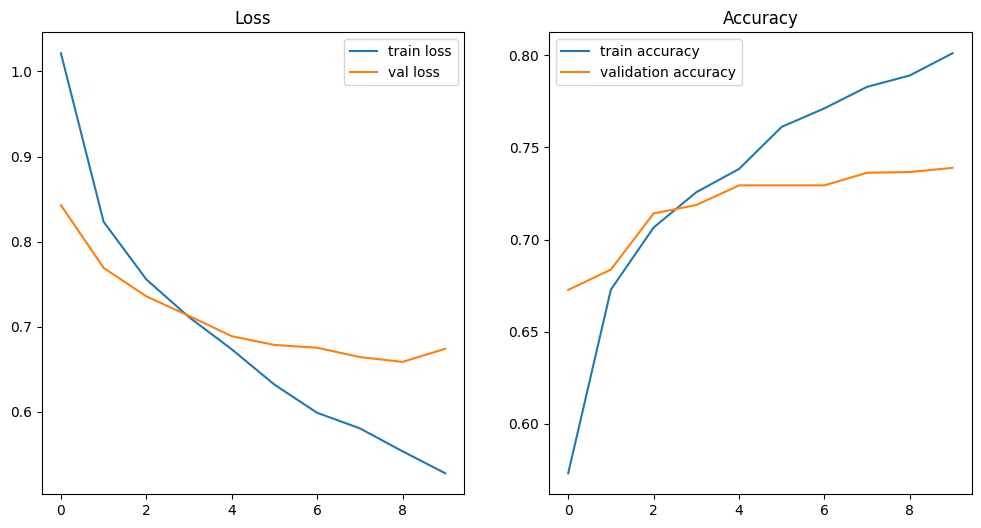

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## using another optimiser, RSMprop

In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])


Epoch 1/10
330/330 [==============================] - 25s 73ms/step - loss: 0.7486 - accuracy: 0.7096 - val_loss: 0.7163 - val_accuracy: 0.7115
Epoch 2/10
330/330 [==============================] - 23s 69ms/step - loss: 0.6765 - accuracy: 0.7369 - val_loss: 0.7011 - val_accuracy: 0.7157
Epoch 3/10
330/330 [==============================] - 24s 73ms/step - loss: 0.6360 - accuracy: 0.7536 - val_loss: 0.6798 - val_accuracy: 0.7359
Epoch 4/10
330/330 [==============================] - 23s 69ms/step - loss: 0.6036 - accuracy: 0.7751 - val_loss: 0.6768 - val_accuracy: 0.7298
Epoch 5/10
330/330 [==============================] - 24s 71ms/step - loss: 0.5762 - accuracy: 0.7824 - val_loss: 0.6713 - val_accuracy: 0.7359
Epoch 6/10
330/330 [==============================] - 23s 70ms/step - loss: 0.5617 - accuracy: 0.7867 - val_loss: 0.6624 - val_accuracy: 0.7355
Epoch 7/10
330/330 [==============================] - 23s 71ms/step - loss: 0.5495 - accuracy: 0.7967 - val_loss: 0.6611 - val_accuracy:

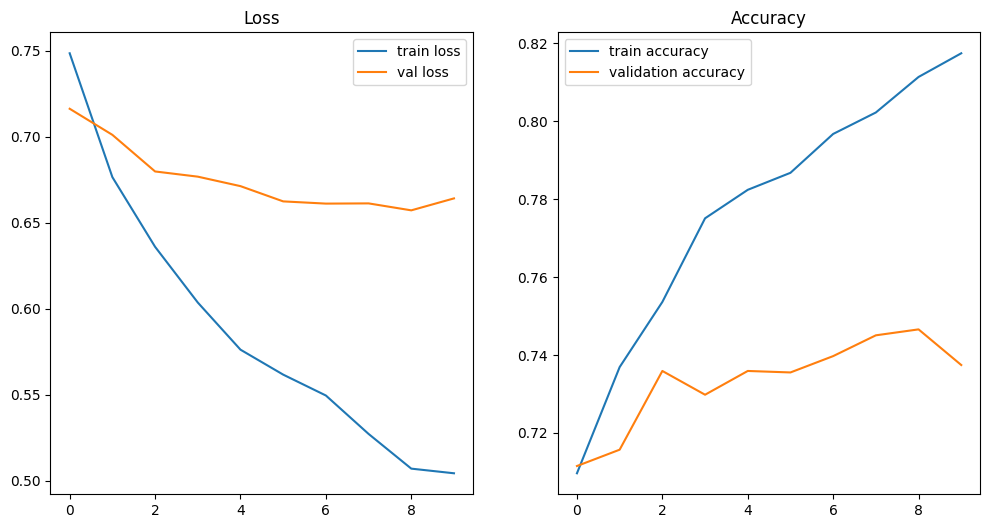

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
### changing optimisers to SGD

In [ ]:
from keras.optimizers import SGD

model.compile(optimizer=SGD(learning_rate=0.00005, momentum=0.9),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 25s 72ms/step - loss: 0.4560 - accuracy: 0.8317 - val_loss: 0.6485 - val_accuracy: 0.7534
Epoch 2/10
330/330 [==============================] - 23s 70ms/step - loss: 0.4521 - accuracy: 0.8383 - val_loss: 0.6466 - val_accuracy: 0.7508
Epoch 3/10
330/330 [==============================] - 23s 70ms/step - loss: 0.4500 - accuracy: 0.8379 - val_loss: 0.6495 - val_accuracy: 0.7496
Epoch 4/10
330/330 [==============================] - 23s 68ms/step - loss: 0.4486 - accuracy: 0.8396 - val_loss: 0.6479 - val_accuracy: 0.7470
Epoch 5/10
330/330 [==============================] - 23s 69ms/step - loss: 0.4488 - accuracy: 0.8384 - val_loss: 0.6470 - val_accuracy: 0.7527
Epoch 6/10
330/330 [==============================] - 23s 68ms/step - loss: 0.4464 - accuracy: 0.8418 - val_loss: 0.6460 - val_accuracy: 0.7504
Epoch 7/10
330/330 [==============================] - 22s 67ms/step - loss: 0.4409 - accuracy: 0.8408 - val_loss: 0.6491 - val_accuracy:

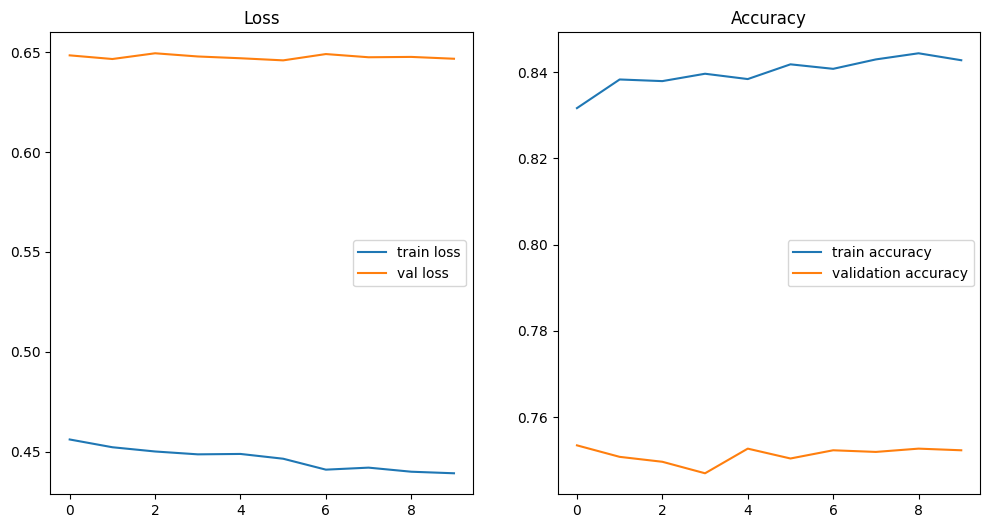

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## changing batch to 64 and optimiser SGD

In [ ]:
# Define image dimensions
img_height, img_width = 128, 128
batch_size = 64

# Create data generators without data augmentation
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

Found 10564 images belonging to 4 classes.
Found 2643 images belonging to 4 classes.


In [ ]:
from keras.optimizers import SGD

model.compile(optimizer=SGD(learning_rate=0.00005, momentum=0.9),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
165/165 [==============================] - 52s 141ms/step - loss: 0.4366 - accuracy: 0.8428 - val_loss: 0.6515 - val_accuracy: 0.7504
Epoch 2/10
165/165 [==============================] - 22s 132ms/step - loss: 0.4366 - accuracy: 0.8427 - val_loss: 0.6462 - val_accuracy: 0.7519
Epoch 3/10
165/165 [==============================] - 21s 129ms/step - loss: 0.4367 - accuracy: 0.8458 - val_loss: 0.6481 - val_accuracy: 0.7538
Epoch 4/10
165/165 [==============================] - 22s 134ms/step - loss: 0.4354 - accuracy: 0.8395 - val_loss: 0.6495 - val_accuracy: 0.7500
Epoch 5/10
165/165 [==============================] - 22s 135ms/step - loss: 0.4462 - accuracy: 0.8393 - val_loss: 0.6437 - val_accuracy: 0.7561
Epoch 6/10
165/165 [==============================] - 21s 127ms/step - loss: 0.4361 - accuracy: 0.8459 - val_loss: 0.6473 - val_accuracy: 0.7542
Epoch 7/10
165/165 [==============================] - 22s 134ms/step - loss: 0.4395 - accuracy: 0.8426 - val_loss: 0.6489 - val_ac

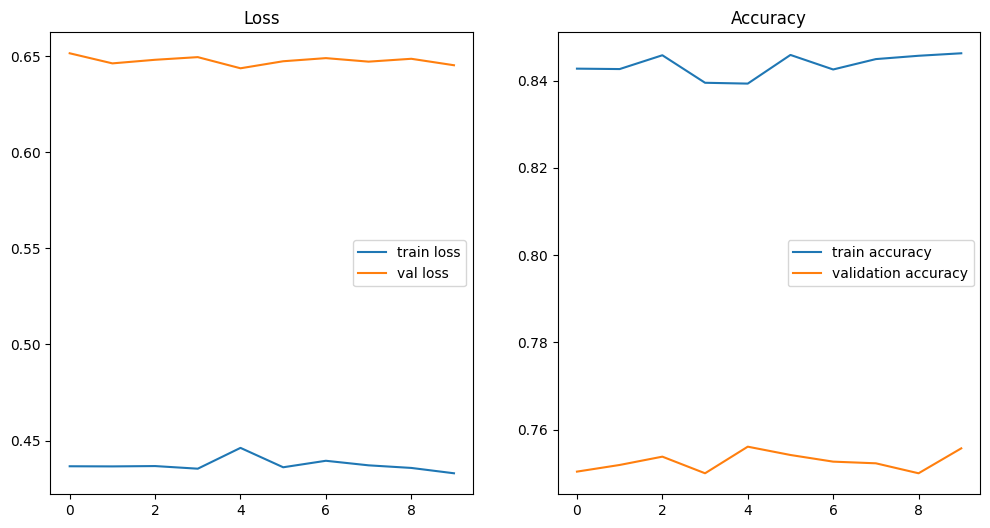

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## batch hamoon 64 vali opt beshe adam - .00005

In [ ]:
from keras.optimizers import Adam

model.compile(optimizer=Adam(learning_rate=0.00005),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:


# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
165/165 [==============================] - 24s 140ms/step - loss: 0.4508 - accuracy: 0.8379 - val_loss: 0.6453 - val_accuracy: 0.7527
Epoch 2/10
165/165 [==============================] - 22s 131ms/step - loss: 0.4391 - accuracy: 0.8423 - val_loss: 0.6463 - val_accuracy: 0.7489
Epoch 3/10
165/165 [==============================] - 22s 133ms/step - loss: 0.4336 - accuracy: 0.8445 - val_loss: 0.6458 - val_accuracy: 0.7550
Epoch 4/10
165/165 [==============================] - 21s 129ms/step - loss: 0.4259 - accuracy: 0.8482 - val_loss: 0.6561 - val_accuracy: 0.7519
Epoch 5/10
165/165 [==============================] - 23s 140ms/step - loss: 0.4165 - accuracy: 0.8512 - val_loss: 0.6494 - val_accuracy: 0.7485
Epoch 6/10
165/165 [==============================] - 23s 138ms/step - loss: 0.4087 - accuracy: 0.8544 - val_loss: 0.6441 - val_accuracy: 0.7515
Epoch 7/10
165/165 [==============================] - 22s 133ms/step - loss: 0.4008 - accuracy: 0.8569 - val_loss: 0.6389 - val_ac

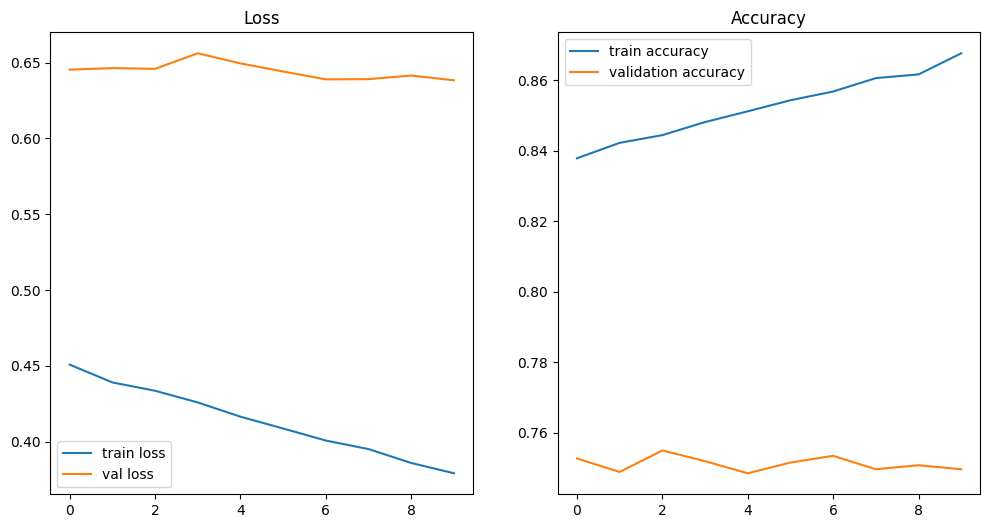

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## batch 64 , opt= RSMprop 0.00005

In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.00005),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])


Epoch 1/10
165/165 [==============================] - 24s 141ms/step - loss: 0.3740 - accuracy: 0.8707 - val_loss: 0.6407 - val_accuracy: 0.7504
Epoch 2/10
165/165 [==============================] - 22s 135ms/step - loss: 0.3707 - accuracy: 0.8704 - val_loss: 0.6424 - val_accuracy: 0.7477
Epoch 3/10
165/165 [==============================] - 22s 134ms/step - loss: 0.3650 - accuracy: 0.8741 - val_loss: 0.6503 - val_accuracy: 0.7530
Epoch 4/10
165/165 [==============================] - 22s 133ms/step - loss: 0.3577 - accuracy: 0.8778 - val_loss: 0.6521 - val_accuracy: 0.7504
Epoch 5/10
165/165 [==============================] - 21s 130ms/step - loss: 0.3493 - accuracy: 0.8790 - val_loss: 0.6492 - val_accuracy: 0.7550
Epoch 6/10
165/165 [==============================] - 22s 134ms/step - loss: 0.3482 - accuracy: 0.8791 - val_loss: 0.6476 - val_accuracy: 0.7504
Epoch 7/10
165/165 [==============================] - 23s 138ms/step - loss: 0.3467 - accuracy: 0.8786 - val_loss: 0.6488 - val_ac

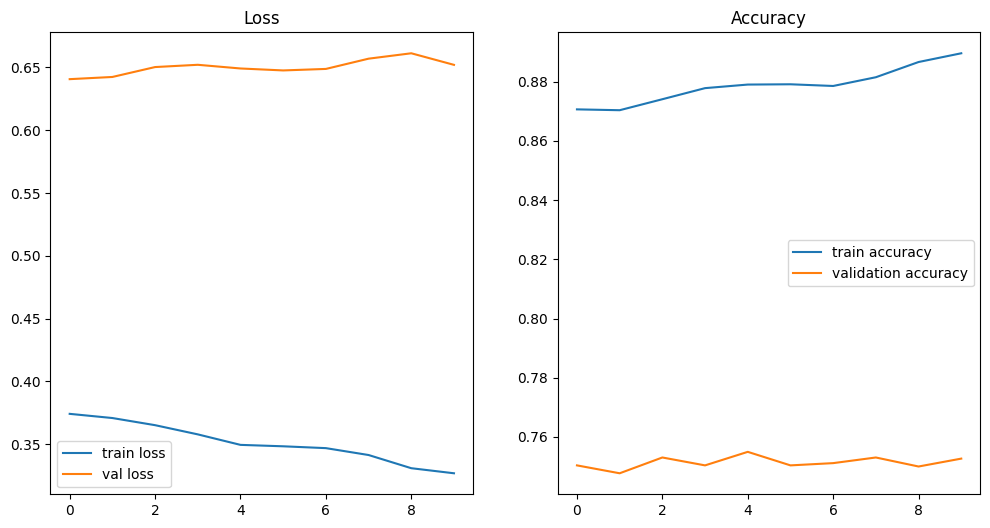

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## batch = 32 , opt= RSMprop - 0.0001

In [ ]:
# Define image dimensions
img_height, img_width = 128, 128
batch_size = 32

# Create data generators without data augmentation
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

Found 10564 images belonging to 4 classes.
Found 2643 images belonging to 4 classes.


In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 25s 74ms/step - loss: 0.3575 - accuracy: 0.8700 - val_loss: 0.6567 - val_accuracy: 0.7500
Epoch 2/10
330/330 [==============================] - 22s 68ms/step - loss: 0.3494 - accuracy: 0.8754 - val_loss: 0.6651 - val_accuracy: 0.7538
Epoch 3/10
330/330 [==============================] - 23s 69ms/step - loss: 0.3416 - accuracy: 0.8787 - val_loss: 0.7017 - val_accuracy: 0.7511
Epoch 4/10
330/330 [==============================] - 24s 74ms/step - loss: 0.3279 - accuracy: 0.8808 - val_loss: 0.6881 - val_accuracy: 0.7534
Epoch 5/10
330/330 [==============================] - 22s 68ms/step - loss: 0.3215 - accuracy: 0.8854 - val_loss: 0.6804 - val_accuracy: 0.7569
Epoch 6/10
330/330 [==============================] - 23s 70ms/step - loss: 0.3148 - accuracy: 0.8907 - val_loss: 0.6899 - val_accuracy: 0.7530
Epoch 7/10
330/330 [==============================] - 22s 68ms/step - loss: 0.3096 - accuracy: 0.8914 - val_loss: 0.6876 - val_accuracy:

In [ ]:
## through the previous code i want the epoch 9 , so i re run the model but this time with 9 epochs

In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=9,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/9
330/330 [==============================] - 24s 73ms/step - loss: 0.2796 - accuracy: 0.9009 - val_loss: 0.6972 - val_accuracy: 0.7538
Epoch 2/9
330/330 [==============================] - 23s 69ms/step - loss: 0.2689 - accuracy: 0.9078 - val_loss: 0.7190 - val_accuracy: 0.7523
Epoch 3/9
330/330 [==============================] - 22s 68ms/step - loss: 0.2726 - accuracy: 0.9037 - val_loss: 0.7460 - val_accuracy: 0.7523
Epoch 4/9
330/330 [==============================] - 24s 72ms/step - loss: 0.2644 - accuracy: 0.9088 - val_loss: 0.7344 - val_accuracy: 0.7504
Epoch 5/9
330/330 [==============================] - 23s 68ms/step - loss: 0.2501 - accuracy: 0.9140 - val_loss: 0.7605 - val_accuracy: 0.7511
Epoch 6/9
330/330 [==============================] - 25s 75ms/step - loss: 0.2446 - accuracy: 0.9163 - val_loss: 0.7414 - val_accuracy: 0.7534
Epoch 7/9
330/330 [==============================] - 23s 70ms/step - loss: 0.2410 - accuracy: 0.9204 - val_loss: 0.8217 - val_accuracy: 0.7374

In [ ]:
## in male ghabli hamoon 10 epochs hast

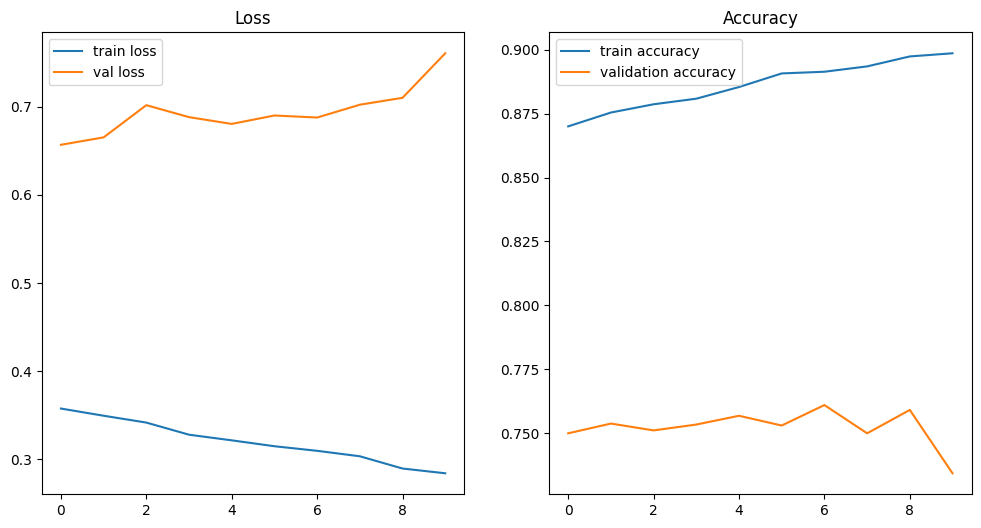

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## in yeki male 9 epoch hast:

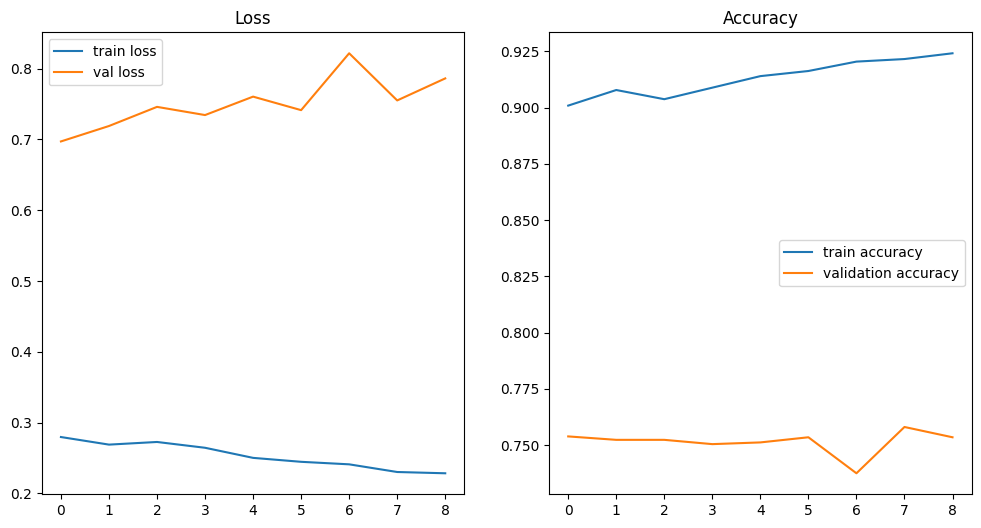

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## prediction male halate 9 epochs

1/1 [==============================] - 1s 1s/step


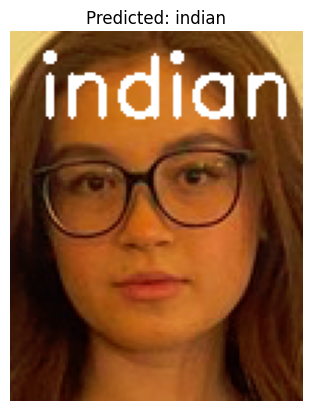

1/1 [==============================] - 0s 18ms/step


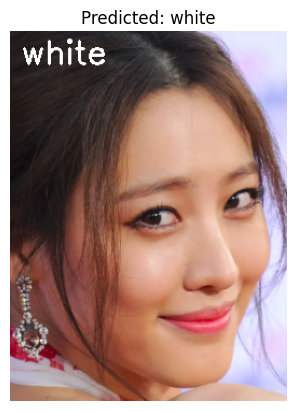

1/1 [==============================] - 0s 18ms/step


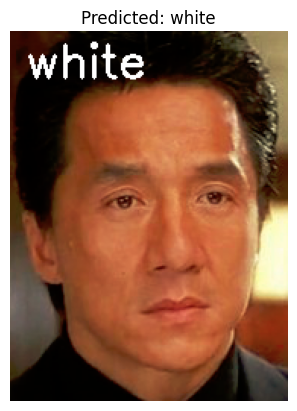

1/1 [==============================] - 0s 21ms/step


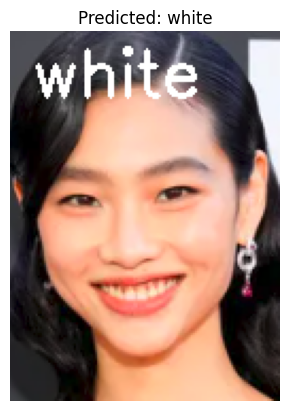

1/1 [==============================] - 0s 17ms/step


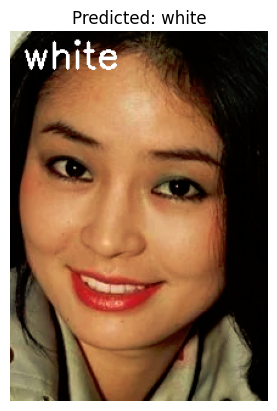

1/1 [==============================] - 0s 17ms/step


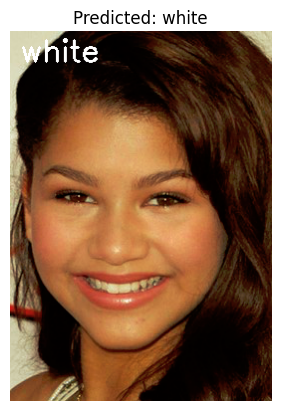

1/1 [==============================] - 0s 17ms/step


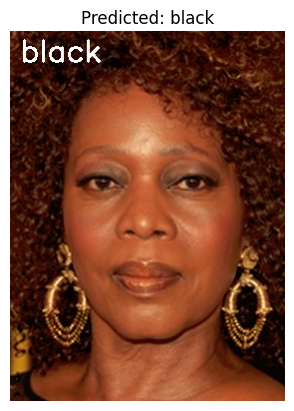

1/1 [==============================] - 0s 19ms/step


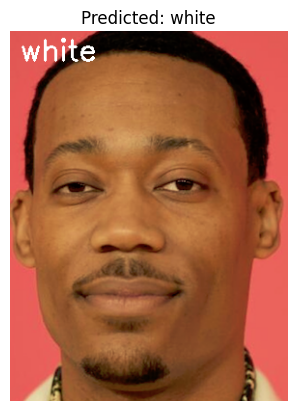

1/1 [==============================] - 0s 17ms/step


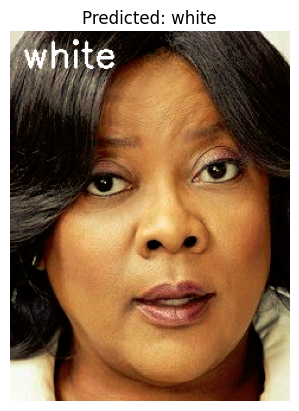

1/1 [==============================] - 0s 25ms/step


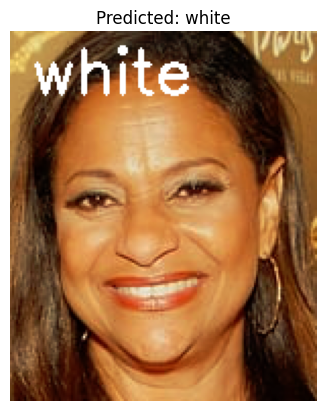

1/1 [==============================] - 0s 18ms/step


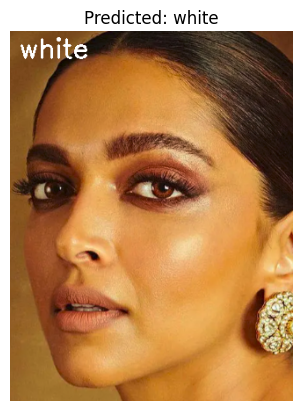

1/1 [==============================] - 0s 29ms/step


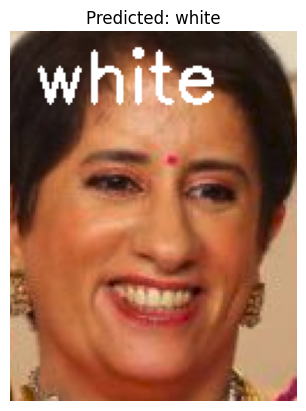

1/1 [==============================] - 0s 21ms/step


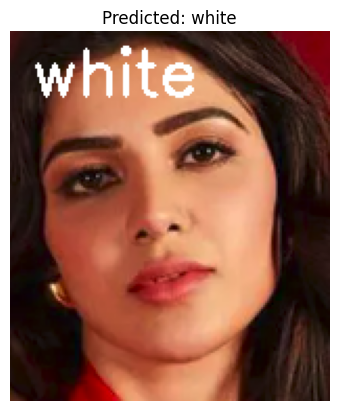

1/1 [==============================] - 0s 21ms/step


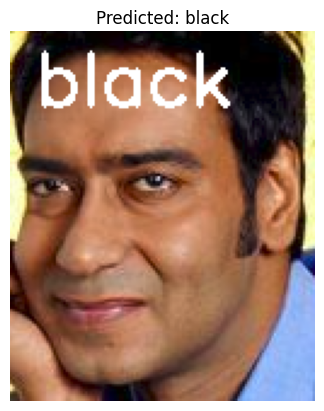

1/1 [==============================] - 0s 22ms/step


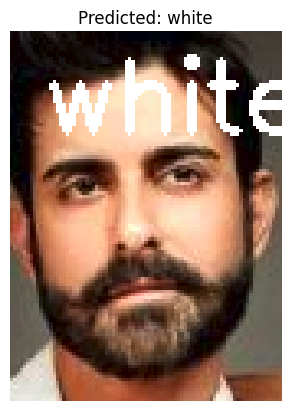

1/1 [==============================] - 0s 17ms/step


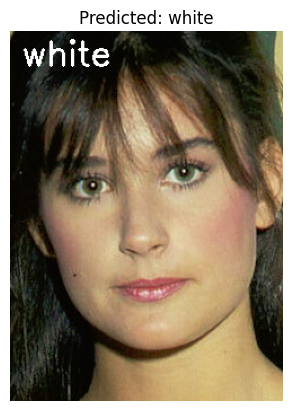

1/1 [==============================] - 0s 24ms/step


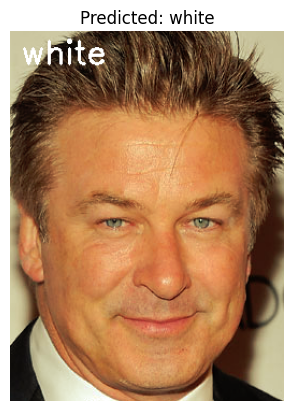

1/1 [==============================] - 0s 25ms/step


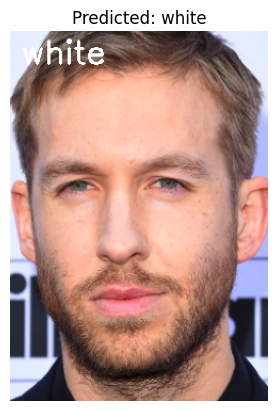

1/1 [==============================] - 0s 36ms/step


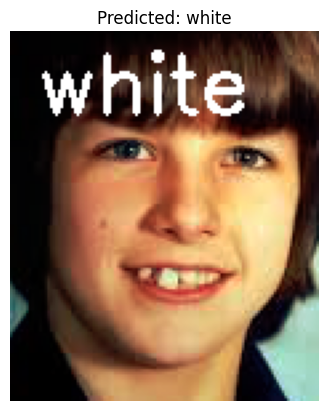

1/1 [==============================] - 0s 20ms/step


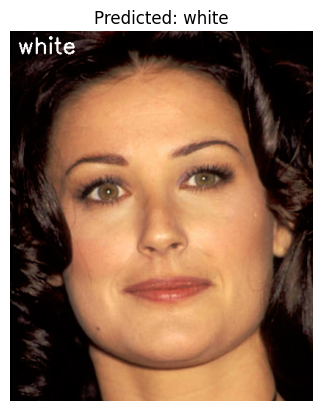

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
## erick prediction

from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg19 import preprocess_input
import numpy as np

def load_and_prepare_image(image_path):
    img = image.load_img(image_path, target_size=(128, 128))
    img_array = image.img_to_array(img)

    # Rescale the image
    img_array /= 255.0

    img_array_expanded = np.expand_dims(img_array, axis=0)
    return preprocess_input(img_array_expanded)


def predict_image(model, image_path):
    processed_image = load_and_prepare_image(image_path)
    predictions = model.predict(processed_image)
    return predictions

def get_prediction_percentage(predictions):
    class_labels = ['asian', 'black', 'indian', 'white'] # Ensure labels are ordered correctly as per your model's training
    percentages = predictions[0] * 100  # Convert probabilities to percentages
    confidence_dict = {label: float(conf) for label, conf in zip(class_labels, percentages)}
    return confidence_dict

def get_prediction_label(predictions):
    class_labels = ['asian', 'black', 'indian', 'white']  # Adjust based on how your folders are labeled and the order of classes
    predicted_class = class_labels[np.argmax(predictions)]
    return predicted_class


image_path =  "/content/test_dataset/specific_dataset/asian/Charles Melton.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 31ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/asian/Screenshot 2024-04-17 at 14.09.30.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:

image_path =  "/content/test_dataset/specific_dataset/black/256.jpg" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 29ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Aamir Khan 3.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Guneet Monga.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
## batch=32, epoch=10, opt=adam - 0.0001

In [ ]:
# Compile the model
model.compile(optimizer=optimizers.Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 26s 74ms/step - loss: 0.2195 - accuracy: 0.9284 - val_loss: 0.7561 - val_accuracy: 0.7542
Epoch 2/10
330/330 [==============================] - 23s 68ms/step - loss: 0.2156 - accuracy: 0.9296 - val_loss: 0.7584 - val_accuracy: 0.7542
Epoch 3/10
330/330 [==============================] - 22s 68ms/step - loss: 0.2027 - accuracy: 0.9321 - val_loss: 0.7973 - val_accuracy: 0.7420
Epoch 4/10
330/330 [==============================] - 23s 69ms/step - loss: 0.1959 - accuracy: 0.9346 - val_loss: 0.7553 - val_accuracy: 0.7550
Epoch 5/10
330/330 [==============================] - 24s 72ms/step - loss: 0.1888 - accuracy: 0.9381 - val_loss: 0.7740 - val_accuracy: 0.7534
Epoch 6/10
330/330 [==============================] - 22s 68ms/step - loss: 0.1822 - accuracy: 0.9418 - val_loss: 0.7768 - val_accuracy: 0.7557
Epoch 7/10
330/330 [==============================] - 24s 73ms/step - loss: 0.1805 - accuracy: 0.9404 - val_loss: 0.7789 - val_accuracy:

In [ ]:
## batch=32, epoch=10, opt= RMSprop(learning_rate=0.0001), data augmentation

In [ ]:
# Define image dimensions and batch size
img_height, img_width = 128, 128
batch_size = 32

# Create data generators with data augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)


Found 10564 images belonging to 4 classes.
Found 2643 images belonging to 4 classes.


In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 59s 177ms/step - loss: 1.0363 - accuracy: 0.6041 - val_loss: 0.7068 - val_accuracy: 0.7412
Epoch 2/10
330/330 [==============================] - 59s 180ms/step - loss: 0.9665 - accuracy: 0.6216 - val_loss: 0.6840 - val_accuracy: 0.7302
Epoch 3/10
330/330 [==============================] - 59s 180ms/step - loss: 0.9391 - accuracy: 0.6344 - val_loss: 0.7060 - val_accuracy: 0.7229
Epoch 4/10
330/330 [==============================] - 60s 182ms/step - loss: 0.9361 - accuracy: 0.6309 - val_loss: 0.6977 - val_accuracy: 0.7359
Epoch 5/10
330/330 [==============================] - 58s 177ms/step - loss: 0.9136 - accuracy: 0.6432 - val_loss: 0.7007 - val_accuracy: 0.7256
Epoch 6/10
330/330 [==============================] - 58s 176ms/step - loss: 0.9234 - accuracy: 0.6423 - val_loss: 0.7160 - val_accuracy: 0.7287
Epoch 7/10
330/330 [==============================] - 59s 179ms/step - loss: 0.9042 - accuracy: 0.6481 - val_loss: 0.6918 - val_ac

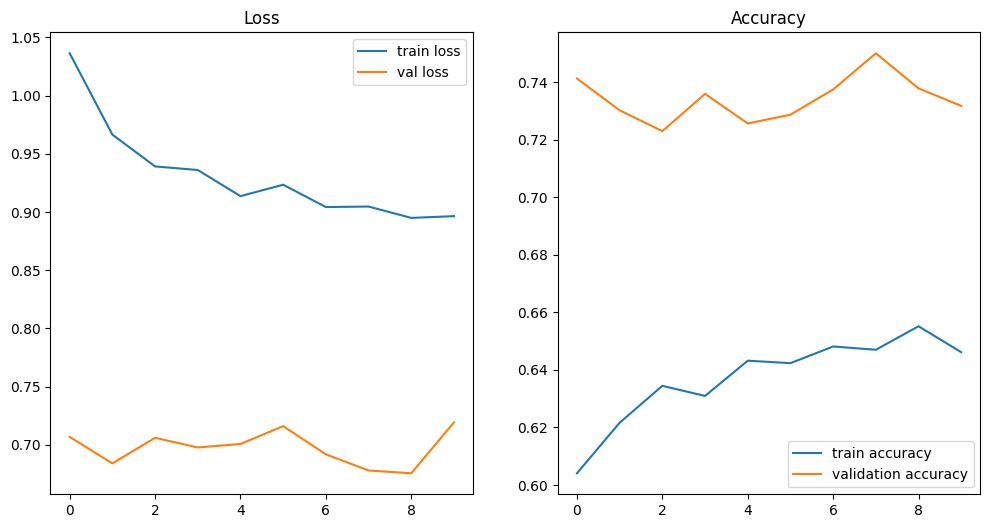

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Guneet Monga.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 201ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Aamir Khan 3.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/256.jpg" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 51ms/step
Confidence levels:
asian: 0.00%
black: 0.00%
indian: 0.00%
white: 100.00%


In [ ]:
###### adjusting layers #######

In [ ]:
# 1-
## using another fine tunning by adjasting layers
## beside using data augmentation
# batch =32, epoch = 10, opt = RSMprop - 0.0001

In [ ]:
# Instead of freezing all the layers of the pre-trained VGG19 model, you can try fine-tuning some of the later layers.
# This allows the model to adapt and learn more specific features from your dataset

from tensorflow.keras import models
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model


# Load the pre-trained VGG19 model
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

for layer in base_model.layers[-4:]:
    layer.trainable = True


# Add a global spatial average pooling layer
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Add a fully-connected layer
x = Dense(1024, activation='relu')(x)

# Add another fully-connected layer
x = Dense(512, activation='relu')(x)

# Add another fully-connected layer with 256 units and 'sigmoid' activation
x = Dense(256, activation='relu')(x)


# Add a logistic layer with softmax activation for classification
predictions = Dense(num_classes, activation='softmax')(x)

# Define the model
model = Model(inputs=base_model.input, outputs=predictions)




In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])


Epoch 1/10
330/330 [==============================] - 89s 236ms/step - loss: 1.2748 - accuracy: 0.4594 - val_loss: 1.2456 - val_accuracy: 0.3998
Epoch 2/10
330/330 [==============================] - 77s 233ms/step - loss: 1.0567 - accuracy: 0.5672 - val_loss: 0.8599 - val_accuracy: 0.6498
Epoch 3/10
330/330 [==============================] - 80s 244ms/step - loss: 0.8077 - accuracy: 0.6892 - val_loss: 0.5674 - val_accuracy: 0.7915
Epoch 4/10
330/330 [==============================] - 75s 228ms/step - loss: 0.6578 - accuracy: 0.7568 - val_loss: 0.5807 - val_accuracy: 0.7873
Epoch 5/10
330/330 [==============================] - 75s 227ms/step - loss: 0.5922 - accuracy: 0.7860 - val_loss: 0.4928 - val_accuracy: 0.8285
Epoch 6/10
330/330 [==============================] - 85s 257ms/step - loss: 0.5293 - accuracy: 0.8084 - val_loss: 0.4197 - val_accuracy: 0.8571
Epoch 7/10
330/330 [==============================] - 77s 234ms/step - loss: 0.4897 - accuracy: 0.8249 - val_loss: 0.4962 - val_ac

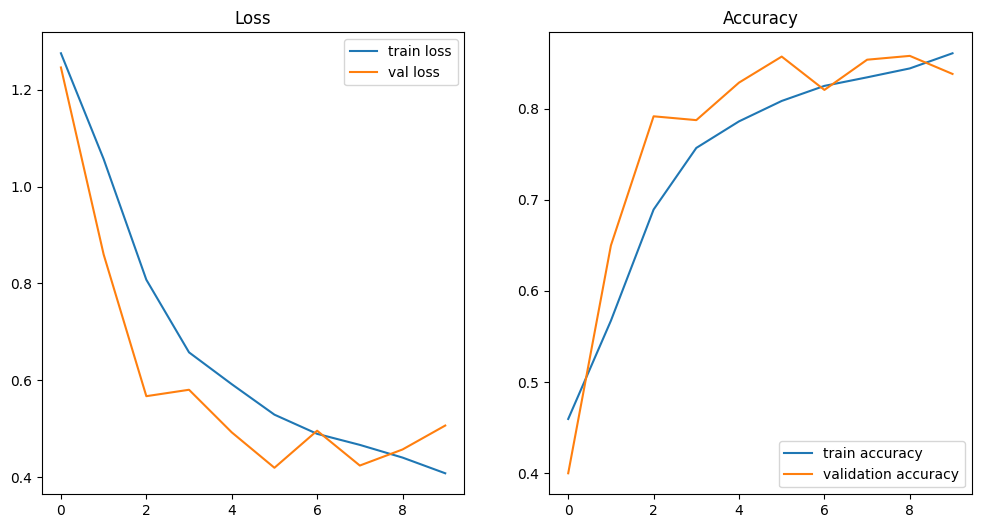

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## prediction

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg19 import preprocess_input
import numpy as np

def load_and_prepare_image(image_path):
    img = image.load_img(image_path, target_size=(128, 128))
    img_array = image.img_to_array(img)

    # Rescale the image
    img_array /= 255.0

    img_array_expanded = np.expand_dims(img_array, axis=0)
    return preprocess_input(img_array_expanded)


def predict_image(model, image_path):
    processed_image = load_and_prepare_image(image_path)
    predictions = model.predict(processed_image)
    return predictions

def get_prediction_percentage(predictions):
    class_labels = ['asian', 'black', 'indian', 'white'] # Ensure labels are ordered correctly as per your model's training
    percentages = predictions[0] * 100  # Convert probabilities to percentages
    confidence_dict = {label: float(conf) for label, conf in zip(class_labels, percentages)}
    return confidence_dict

def get_prediction_label(predictions):
    class_labels = ['asian', 'black', 'indian', 'white']  # Adjust based on how your folders are labeled and the order of classes
    predicted_class = class_labels[np.argmax(predictions)]
    return predicted_class


image_path = '/content/test_dataset/specific_dataset/black/256.jpg'  # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 11.19%
black: 9.39%
indian: 27.69%
white: 51.73%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Aamir Khan 3.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 11.23%
black: 9.50%
indian: 27.81%
white: 51.47%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Guneet Monga.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 11.27%
black: 9.41%
indian: 28.13%
white: 51.19%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/53.jpeg" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 11.12%
black: 9.32%
indian: 27.61%
white: 51.95%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/asian/Ian Chen.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 29ms/step
Confidence levels:
asian: 11.15%
black: 9.30%
indian: 27.90%
white: 51.66%


1/1 [==============================] - 0s 18ms/step


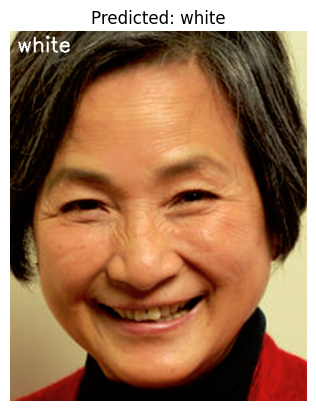

1/1 [==============================] - 0s 17ms/step


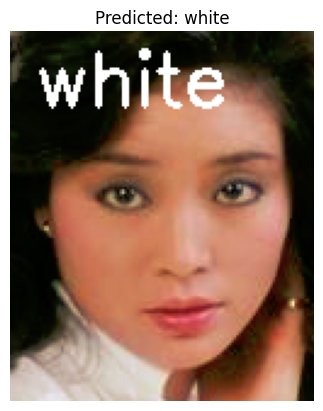

1/1 [==============================] - 0s 18ms/step


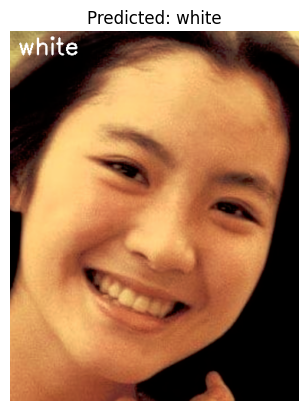

1/1 [==============================] - 0s 34ms/step


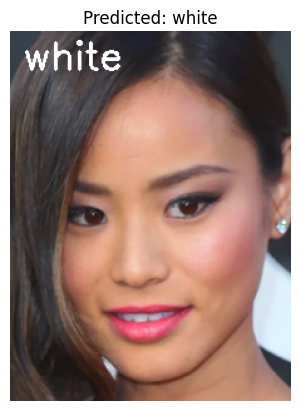

1/1 [==============================] - 0s 27ms/step


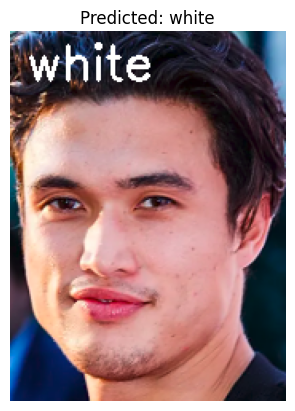

1/1 [==============================] - 0s 27ms/step


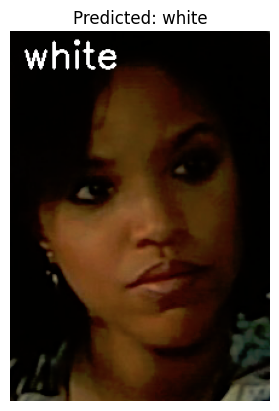

1/1 [==============================] - 0s 18ms/step


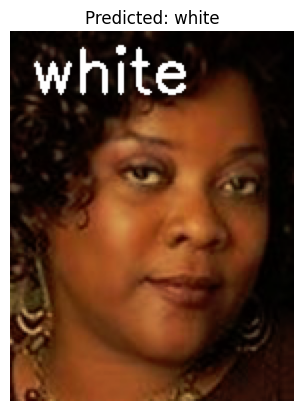

1/1 [==============================] - 0s 18ms/step


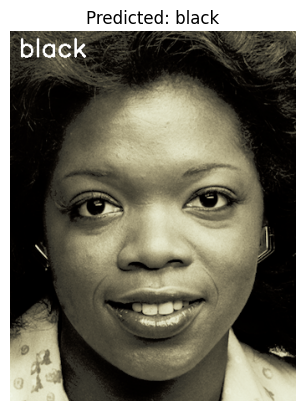

1/1 [==============================] - 0s 27ms/step


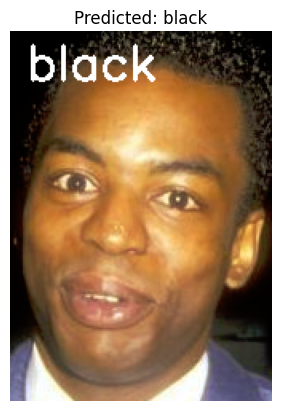

1/1 [==============================] - 0s 19ms/step


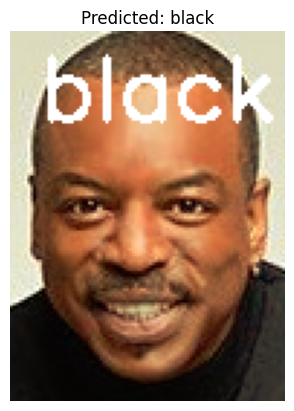

1/1 [==============================] - 0s 20ms/step


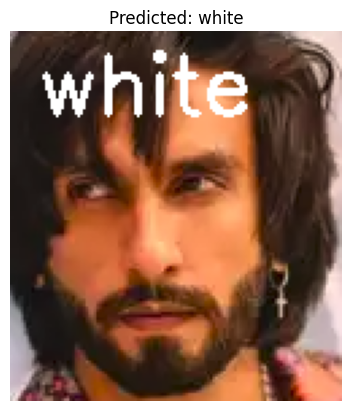

1/1 [==============================] - 0s 20ms/step


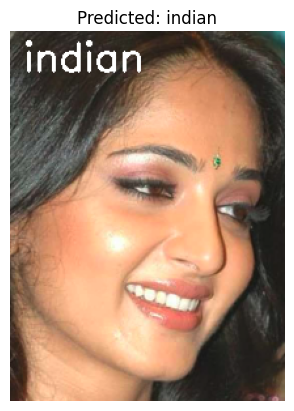

1/1 [==============================] - 0s 20ms/step


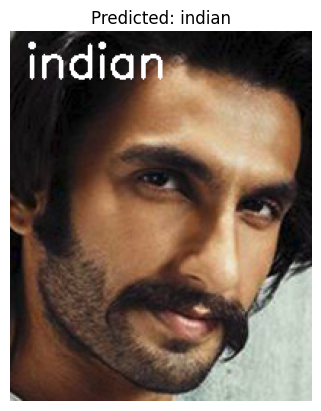

1/1 [==============================] - 0s 21ms/step


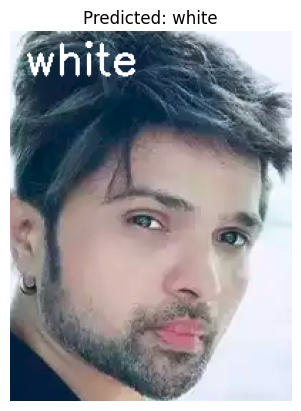

1/1 [==============================] - 0s 18ms/step


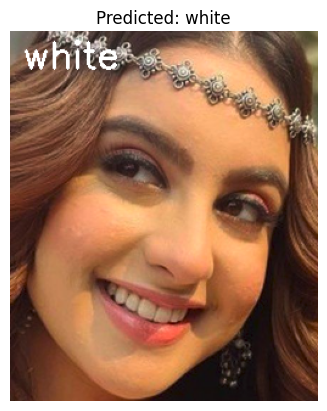

1/1 [==============================] - 0s 25ms/step


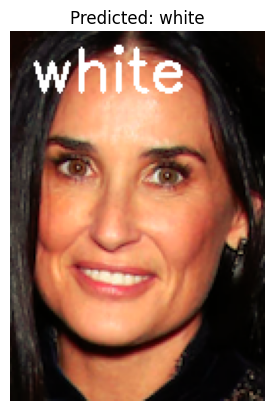

1/1 [==============================] - 0s 21ms/step


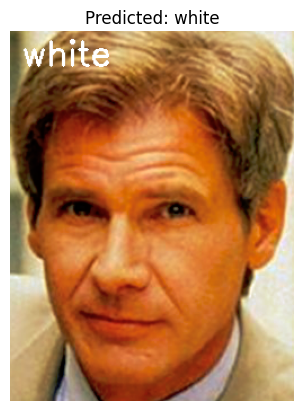

1/1 [==============================] - 0s 27ms/step


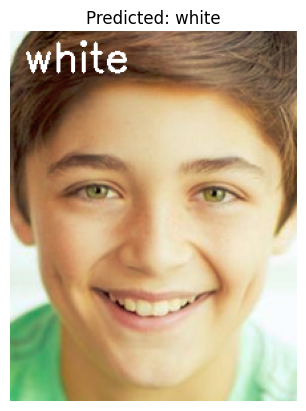

1/1 [==============================] - 0s 23ms/step


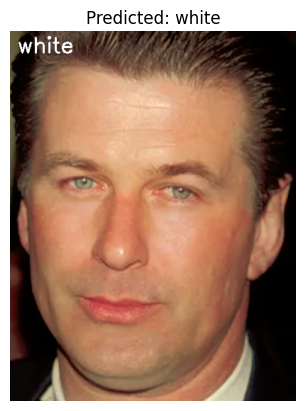

1/1 [==============================] - 0s 24ms/step


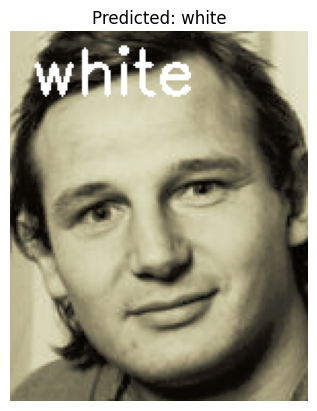

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
## adding 5 more epochs to the last model

In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=15,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/15
330/330 [==============================] - 76s 231ms/step - loss: 0.3855 - accuracy: 0.8680 - val_loss: 0.4476 - val_accuracy: 0.8384
Epoch 2/15
330/330 [==============================] - 75s 227ms/step - loss: 0.3744 - accuracy: 0.8719 - val_loss: 0.3661 - val_accuracy: 0.8704
Epoch 3/15
330/330 [==============================] - 74s 224ms/step - loss: 0.3605 - accuracy: 0.8803 - val_loss: 0.3651 - val_accuracy: 0.8773
Epoch 4/15
330/330 [==============================] - 74s 225ms/step - loss: 0.3441 - accuracy: 0.8858 - val_loss: 0.3565 - val_accuracy: 0.8807
Epoch 5/15
330/330 [==============================] - 75s 225ms/step - loss: 0.3228 - accuracy: 0.8919 - val_loss: 0.4039 - val_accuracy: 0.8834
Epoch 6/15
330/330 [==============================] - 76s 229ms/step - loss: 0.3166 - accuracy: 0.8937 - val_loss: 0.6059 - val_accuracy: 0.7988
Epoch 7/15
330/330 [==============================] - 75s 227ms/step - loss: 0.3048 - accuracy: 0.8963 - val_loss: 0.3591 - val_ac

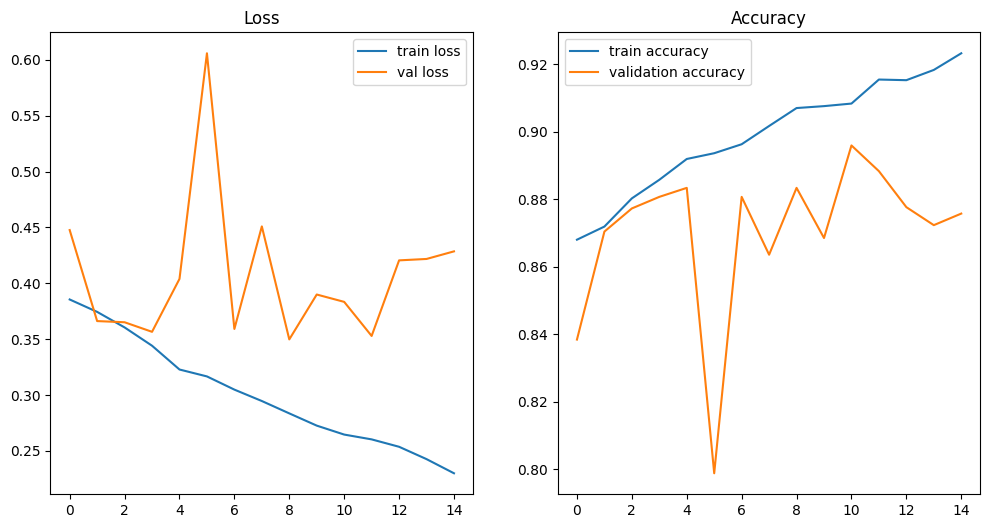

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

1/1 [==============================] - 0s 20ms/step


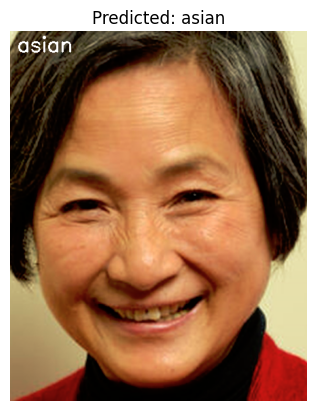

1/1 [==============================] - 0s 18ms/step


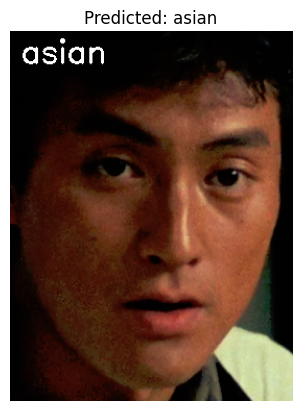

1/1 [==============================] - 0s 17ms/step


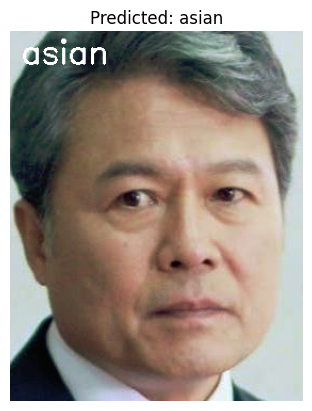

1/1 [==============================] - 0s 18ms/step


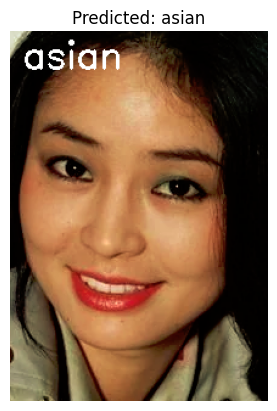

1/1 [==============================] - 0s 23ms/step


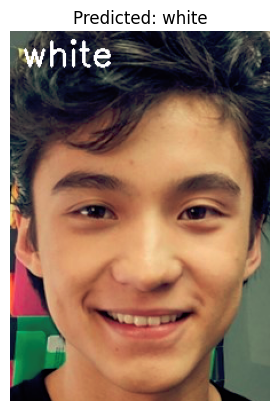

1/1 [==============================] - 0s 18ms/step


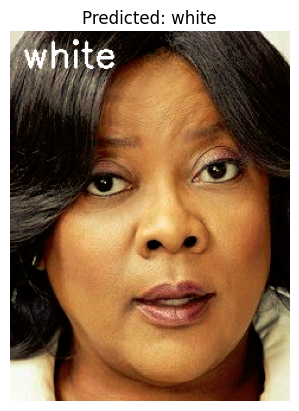

1/1 [==============================] - 0s 17ms/step


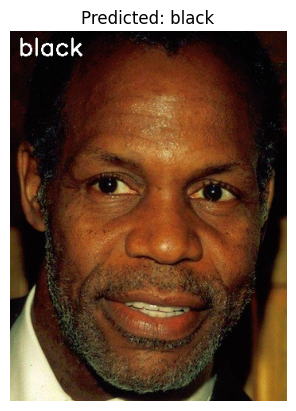

1/1 [==============================] - 0s 28ms/step


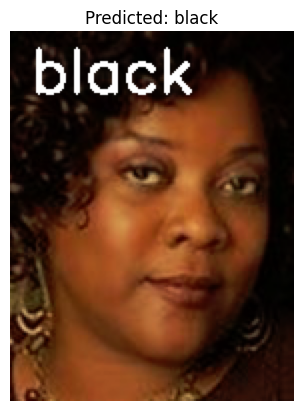

1/1 [==============================] - 0s 19ms/step


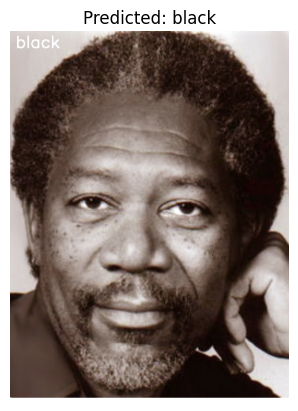

1/1 [==============================] - 0s 19ms/step


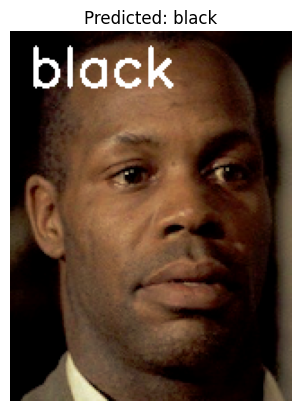

1/1 [==============================] - 0s 18ms/step


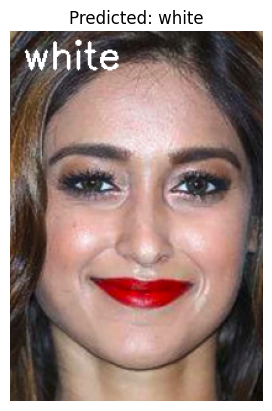

1/1 [==============================] - 0s 18ms/step


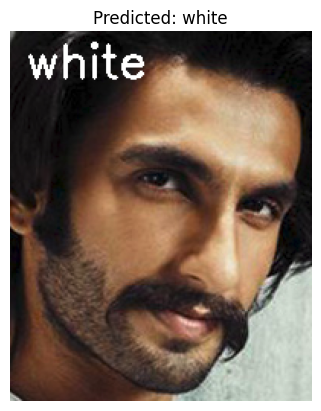

1/1 [==============================] - 0s 22ms/step


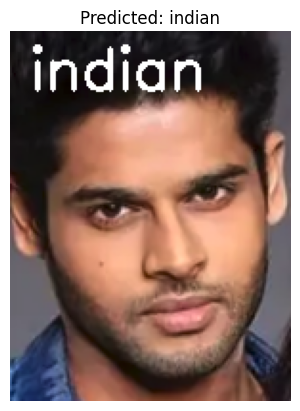

1/1 [==============================] - 0s 20ms/step


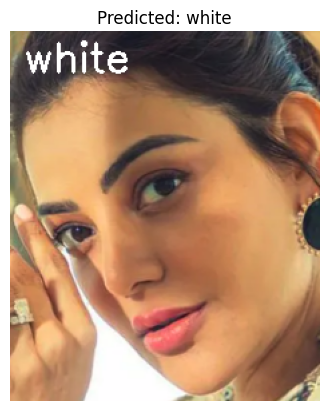

1/1 [==============================] - 0s 21ms/step


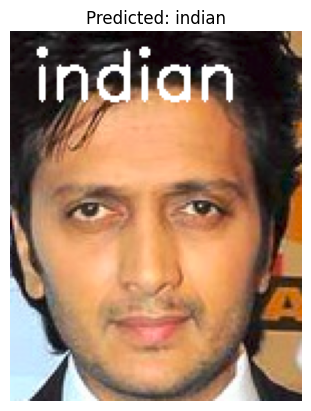

1/1 [==============================] - 0s 23ms/step


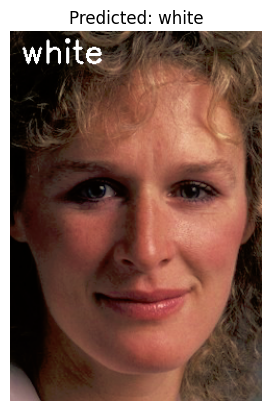

1/1 [==============================] - 0s 22ms/step


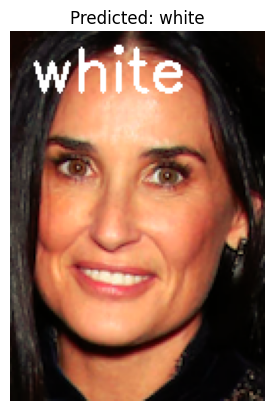

1/1 [==============================] - 0s 29ms/step


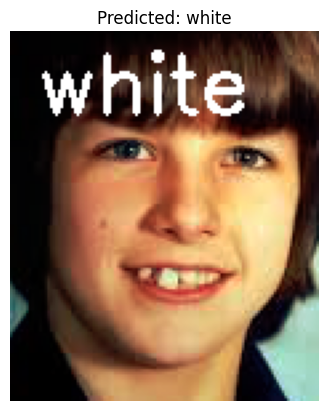

1/1 [==============================] - 0s 22ms/step


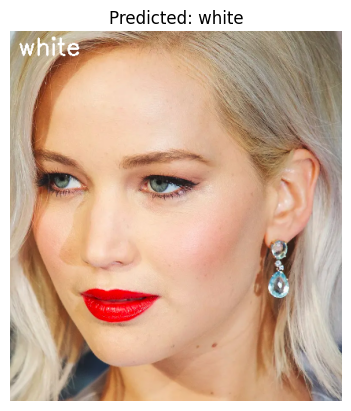

1/1 [==============================] - 0s 32ms/step


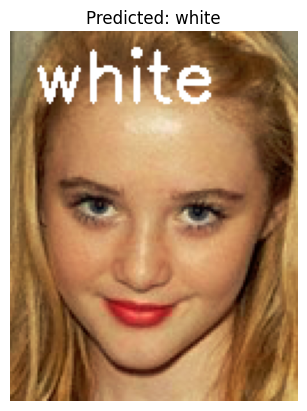

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
image_path =  "/content/test_dataset/specific_dataset/asian/Ian Chen.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 1.13%
black: 16.83%
indian: 79.19%
white: 2.85%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/asian/Screenshot 2024-04-17 at 14.10.35.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 19ms/step
Confidence levels:
asian: 1.14%
black: 17.67%
indian: 78.22%
white: 2.97%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/Screenshot 2024-04-17 at 13.32.19.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 69ms/step
Confidence levels:
asian: 0.96%
black: 17.38%
indian: 79.24%
white: 2.42%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/Screenshot 2024-04-17 at 13.34.59.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 106ms/step
Confidence levels:
asian: 1.09%
black: 17.28%
indian: 78.80%
white: 2.83%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Aditya Narayan.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 33ms/step
Confidence levels:
asian: 1.05%
black: 17.63%
indian: 78.70%
white: 2.62%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Himesh Reshammiya 2.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 0.99%
black: 17.29%
indian: 79.36%
white: 2.36%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Chitrangada Singh.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 1.17%
black: 17.57%
indian: 78.08%
white: 3.17%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/white/Screenshot 2024-04-17 at 14.45.54.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 1.19%
black: 17.79%
indian: 77.75%
white: 3.26%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/white/Screenshot 2024-04-17 at 14.50.24.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 18ms/step
Confidence levels:
asian: 1.12%
black: 17.07%
indian: 79.02%
white: 2.78%


In [ ]:
### i put the epoch = 4

In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=4,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/4
330/330 [==============================] - 75s 228ms/step - loss: 0.2261 - accuracy: 0.9230 - val_loss: 0.4161 - val_accuracy: 0.8872
Epoch 2/4
330/330 [==============================] - 81s 244ms/step - loss: 0.2157 - accuracy: 0.9290 - val_loss: 0.3725 - val_accuracy: 0.8811
Epoch 3/4
330/330 [==============================] - 75s 226ms/step - loss: 0.2124 - accuracy: 0.9308 - val_loss: 0.4080 - val_accuracy: 0.8849
Epoch 4/4
83/83 [==============================] - 5s 54ms/step - loss: 0.3708 - accuracy: 0.8838
Validation Loss: 0.3708278238773346
Validation Accuracy: 0.8838441371917725
Found 241 images belonging to 4 classes.
8/8 [==============================] - 1s 161ms/step - loss: 0.7704 - accuracy: 0.7344
Test Accuracy: 0.7344398498535156
Test Loss: 0.7704471349716187


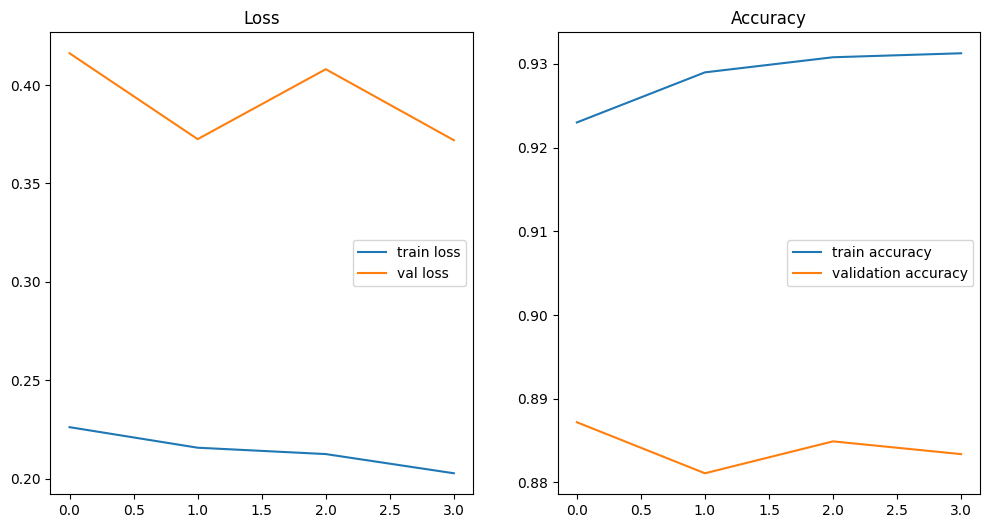

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [ ]:
## this time i try not to use a data augmentation

In [ ]:
## this time i try not to use a data augmentation


In [ ]:
num_classes = 4

# Define image dimensions
img_height, img_width = 128, 128
batch_size = 32

# Create data generators without data augmentation
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

Found 10564 images belonging to 4 classes.
Found 2643 images belonging to 4 classes.


In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=5,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/5
330/330 [==============================] - 63s 189ms/step - loss: 0.1357 - accuracy: 0.9589 - val_loss: 0.4922 - val_accuracy: 0.8670
Epoch 2/5
330/330 [==============================] - 62s 187ms/step - loss: 0.1123 - accuracy: 0.9661 - val_loss: 0.4093 - val_accuracy: 0.8864
Epoch 3/5
330/330 [==============================] - 63s 192ms/step - loss: 0.0892 - accuracy: 0.9729 - val_loss: 0.5232 - val_accuracy: 0.8872
Epoch 4/5
330/330 [==============================] - 62s 187ms/step - loss: 0.0842 - accuracy: 0.9731 - val_loss: 0.6377 - val_accuracy: 0.8822
Epoch 5/5
83/83 [==============================] - 4s 54ms/step - loss: 0.6053 - accuracy: 0.8869
Validation Loss: 0.6053095459938049
Validation Accuracy: 0.8868709802627563
Found 241 images belonging to 4 classes.
8/8 [==============================] - 1s 158ms/step - loss: 0.8301 - accuracy: 0.7842
Test Accuracy: 0.7842323780059814
Test Loss: 0.8300687670707703


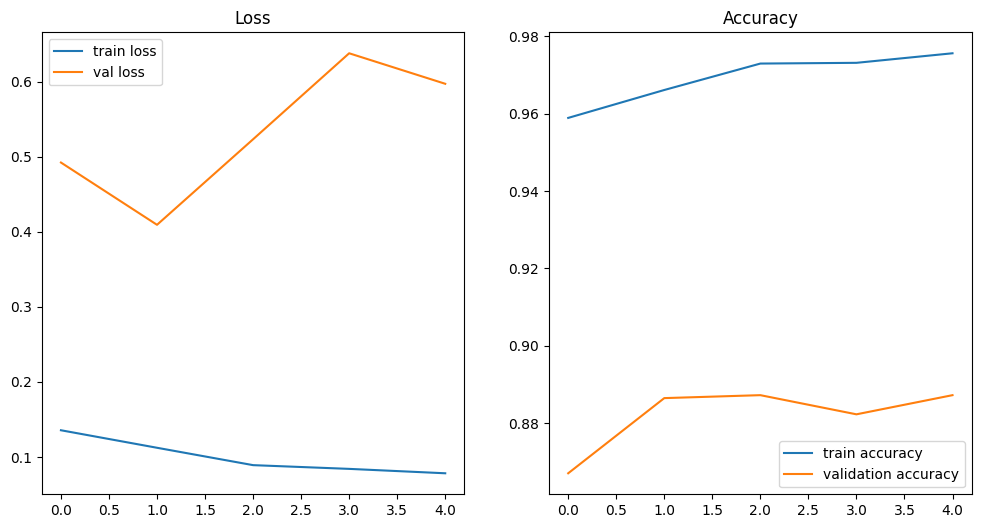

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

1/1 [==============================] - 0s 19ms/step


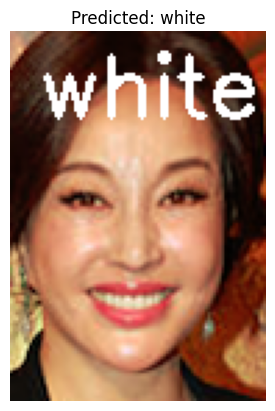

1/1 [==============================] - 0s 18ms/step


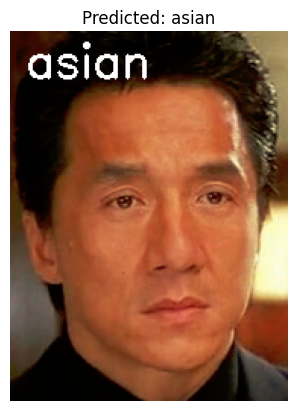

1/1 [==============================] - 0s 19ms/step


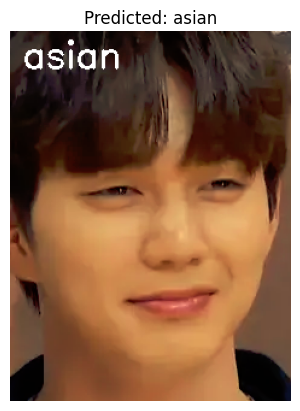

1/1 [==============================] - 0s 20ms/step


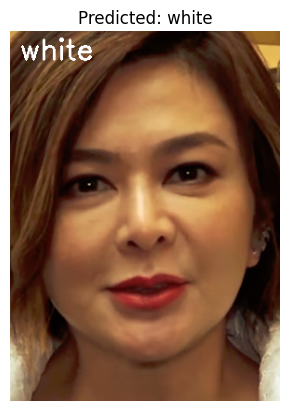

1/1 [==============================] - 0s 19ms/step


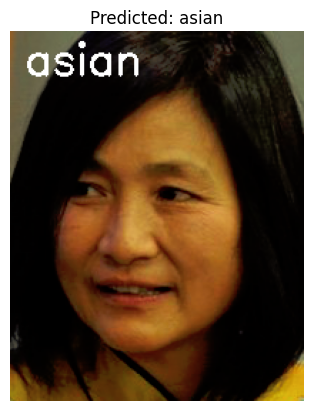

1/1 [==============================] - 0s 18ms/step


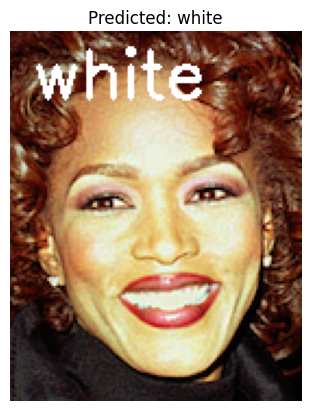

1/1 [==============================] - 0s 24ms/step


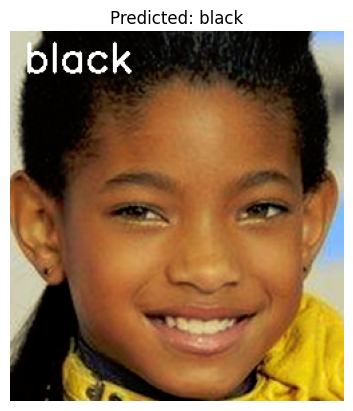

1/1 [==============================] - 0s 19ms/step


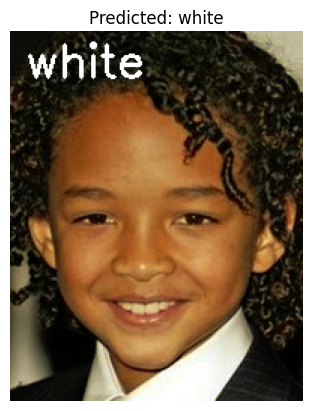

1/1 [==============================] - 0s 25ms/step


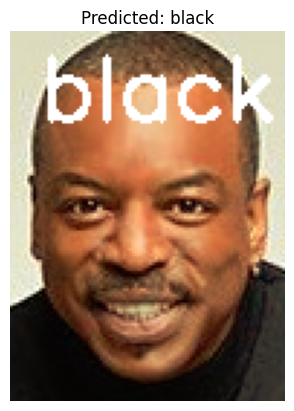

1/1 [==============================] - 0s 20ms/step


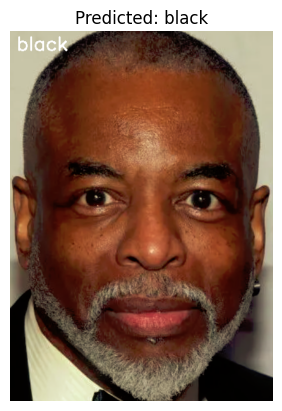

1/1 [==============================] - 0s 19ms/step


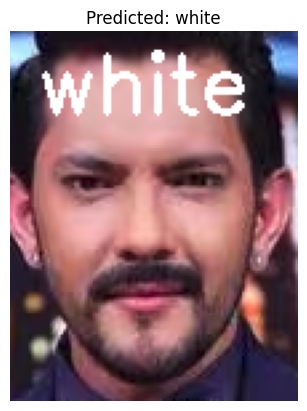

1/1 [==============================] - 0s 30ms/step


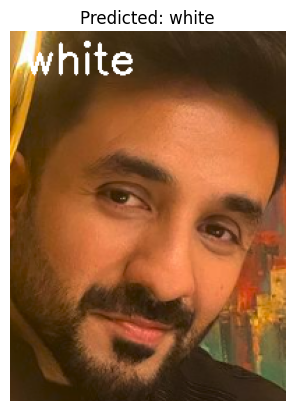

1/1 [==============================] - 0s 53ms/step


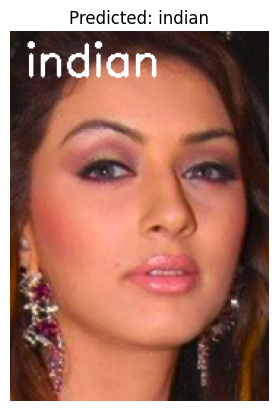

1/1 [==============================] - 0s 31ms/step


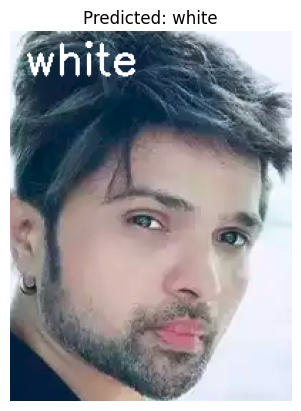

1/1 [==============================] - 0s 34ms/step


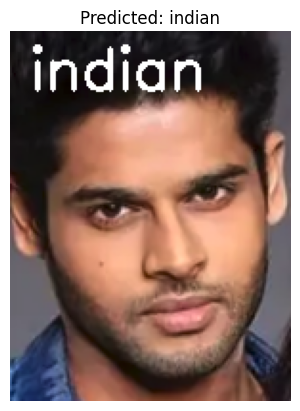

1/1 [==============================] - 0s 43ms/step


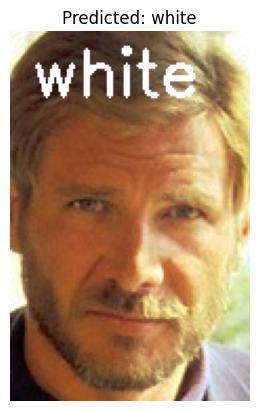

1/1 [==============================] - 0s 31ms/step


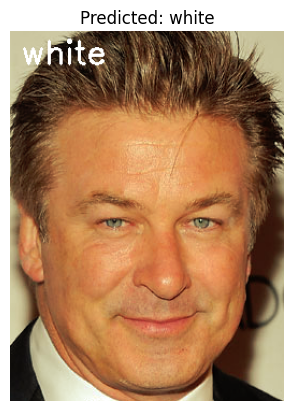

1/1 [==============================] - 0s 32ms/step


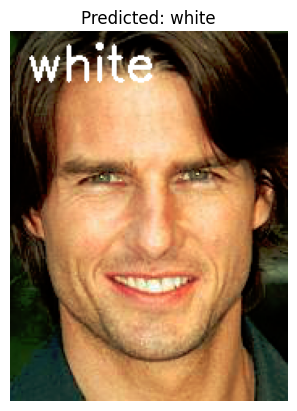

1/1 [==============================] - 0s 48ms/step


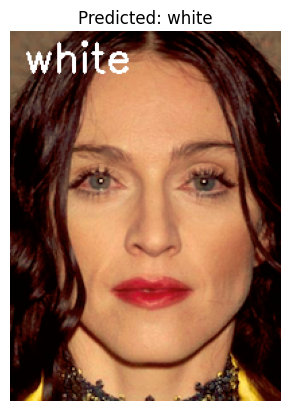

1/1 [==============================] - 0s 32ms/step


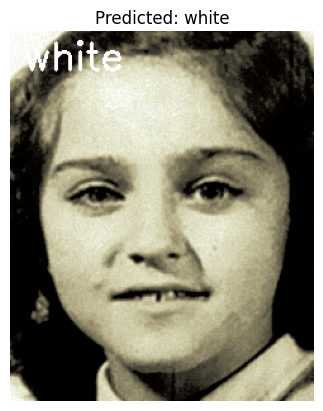

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

1/1 [==============================] - 0s 20ms/step


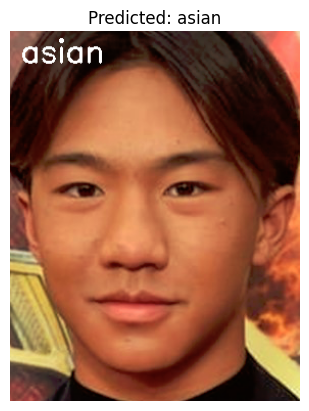

1/1 [==============================] - 0s 18ms/step


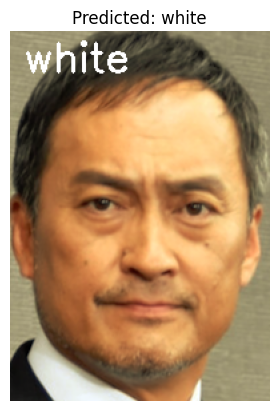

1/1 [==============================] - 0s 18ms/step


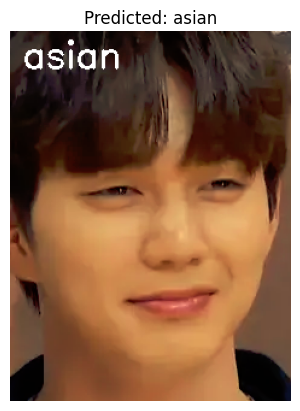

1/1 [==============================] - 0s 18ms/step


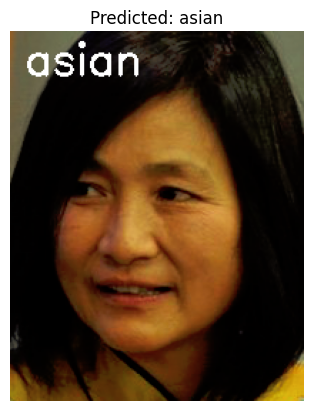

1/1 [==============================] - 0s 18ms/step


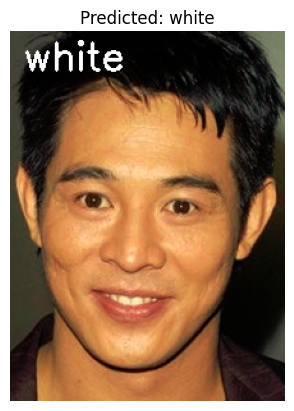

1/1 [==============================] - 0s 19ms/step


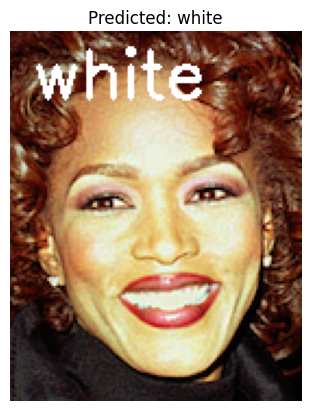

1/1 [==============================] - 0s 23ms/step


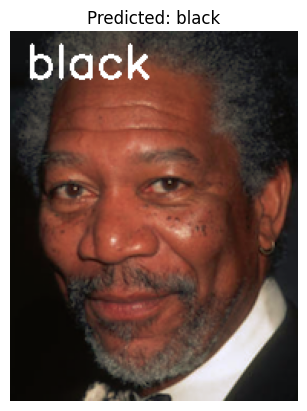

1/1 [==============================] - 0s 20ms/step


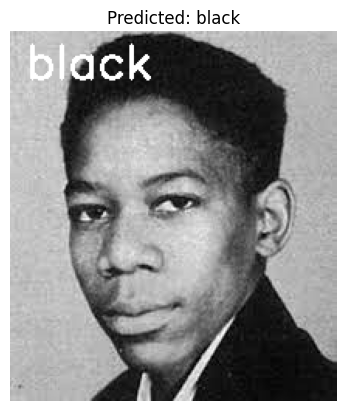

1/1 [==============================] - 0s 19ms/step


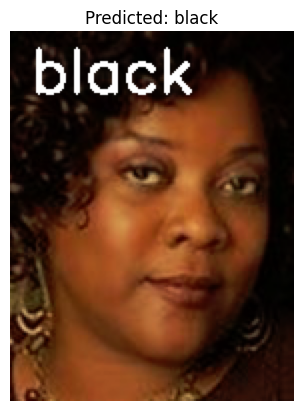

1/1 [==============================] - 0s 19ms/step


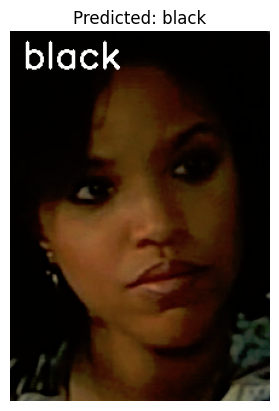

1/1 [==============================] - 0s 19ms/step


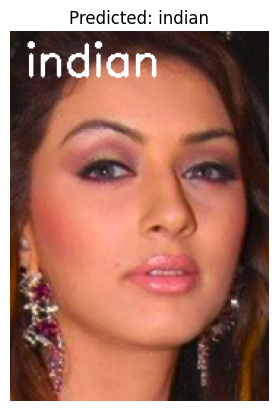

1/1 [==============================] - 0s 28ms/step


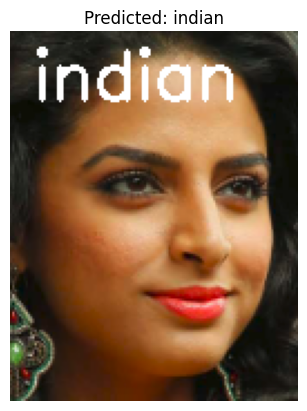

1/1 [==============================] - 0s 25ms/step


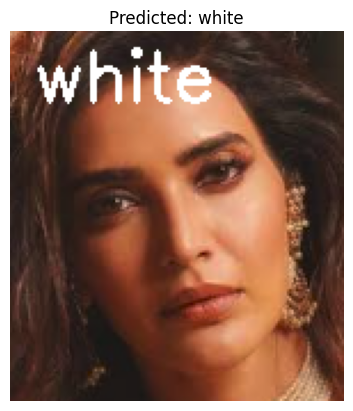

1/1 [==============================] - 0s 21ms/step


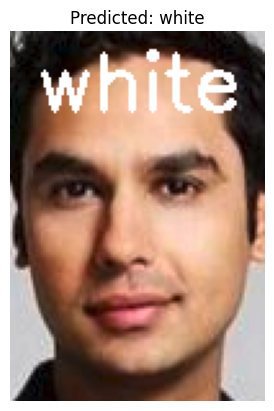

1/1 [==============================] - 0s 22ms/step


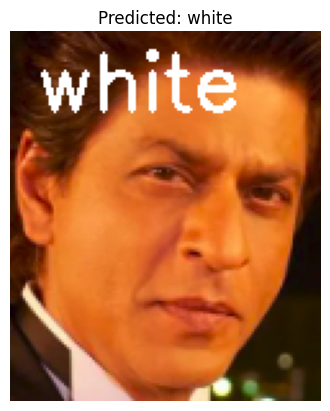

1/1 [==============================] - 0s 18ms/step


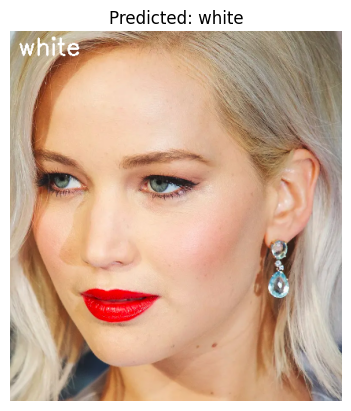

1/1 [==============================] - 0s 41ms/step


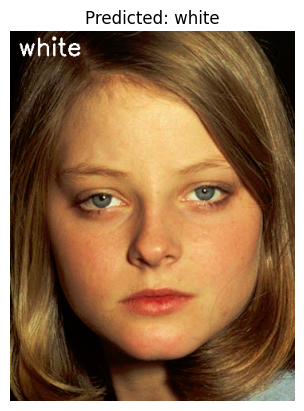

1/1 [==============================] - 0s 34ms/step


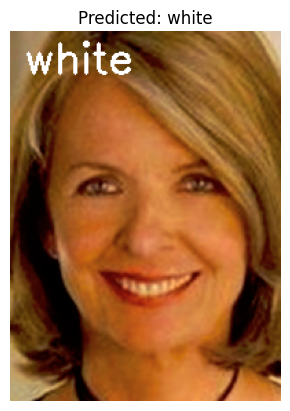

1/1 [==============================] - 0s 28ms/step


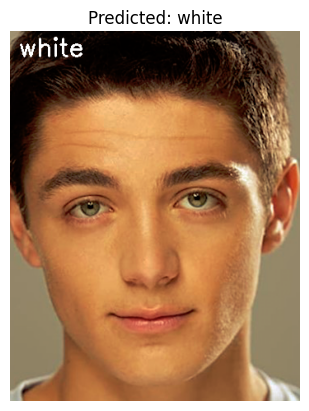

1/1 [==============================] - 0s 42ms/step


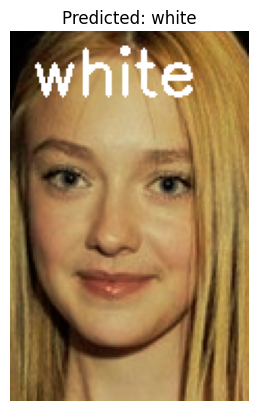

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
image_path =  "/content/test_dataset/specific_dataset/white/Screenshot 2024-04-17 at 14.50.24.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 28ms/step
Confidence levels:
asian: 0.00%
black: 6.20%
indian: 0.00%
white: 93.80%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/48.jpeg" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 27ms/step
Confidence levels:
asian: 0.00%
black: 6.67%
indian: 0.00%
white: 93.33%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/black/Taraji P. Henson.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 71ms/step
Confidence levels:
asian: 0.00%
black: 7.12%
indian: 0.00%
white: 92.88%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/indian/Amrita Rao.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 113ms/step
Confidence levels:
asian: 0.00%
black: 6.55%
indian: 0.00%
white: 93.45%


In [ ]:
image_path =  "/content/test_dataset/specific_dataset/asian/Screenshot 2024-04-17 at 14.11.01.png" # Path to new image
predictions = predict_image(model, image_path)
confidence_levels = get_prediction_percentage(predictions)


print("Confidence levels:")
for label, confidence in confidence_levels.items():
    print(f"{label}: {confidence:.2f}%")

1/1 [==============================] - 0s 28ms/step
Confidence levels:
asian: 0.00%
black: 6.60%
indian: 0.00%
white: 93.40%


In [ ]:
# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=1,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

83/83 [==============================] - 4s 53ms/step - loss: 0.6063 - accuracy: 0.8683
Validation Loss: 0.6063085198402405
Validation Accuracy: 0.8683314323425293
Found 241 images belonging to 4 classes.
8/8 [==============================] - 1s 161ms/step - loss: 1.3170 - accuracy: 0.6556
Test Accuracy: 0.6556016802787781
Test Loss: 1.3169840574264526


In [ ]:
## the model above is not good

In [ ]:
## i use another changes to the layers, without data augmentation

In [ ]:
# Load the pre-trained VGG19 model
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

# Freeze the layers of the pre-trained model
for layer in base_model.layers:
    layer.trainable = False

# Create a new model on top of the pre-trained model
model = models.Sequential()
model.add(base_model)
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(256, activation='relu'))  # Additional dense layer
model.add(layers.Dropout(0.5))
model.add(layers.Dense(128, activation='relu'))  # Additional dense layer
model.add(layers.Dropout(0.5))
model.add(layers.Dense(4, activation='softmax'))  # Output layer with 4 classes for ethnicities

In [ ]:
# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])

Epoch 1/10
330/330 [==============================] - 26s 75ms/step - loss: 1.3301 - accuracy: 0.4056 - val_loss: 1.1603 - val_accuracy: 0.5198
Epoch 2/10
330/330 [==============================] - 23s 71ms/step - loss: 1.1420 - accuracy: 0.5070 - val_loss: 0.9849 - val_accuracy: 0.6002
Epoch 3/10
330/330 [==============================] - 22s 68ms/step - loss: 1.0324 - accuracy: 0.5671 - val_loss: 0.9092 - val_accuracy: 0.6383
Epoch 4/10
330/330 [==============================] - 23s 70ms/step - loss: 0.9612 - accuracy: 0.6077 - val_loss: 0.8523 - val_accuracy: 0.6593
Epoch 5/10
330/330 [==============================] - 23s 71ms/step - loss: 0.9079 - accuracy: 0.6381 - val_loss: 0.8491 - val_accuracy: 0.6562
Epoch 6/10
330/330 [==============================] - 23s 71ms/step - loss: 0.8699 - accuracy: 0.6617 - val_loss: 0.7757 - val_accuracy: 0.6966
Epoch 7/10
330/330 [==============================] - 23s 71ms/step - loss: 0.8305 - accuracy: 0.6789 - val_loss: 0.7703 - val_accuracy:

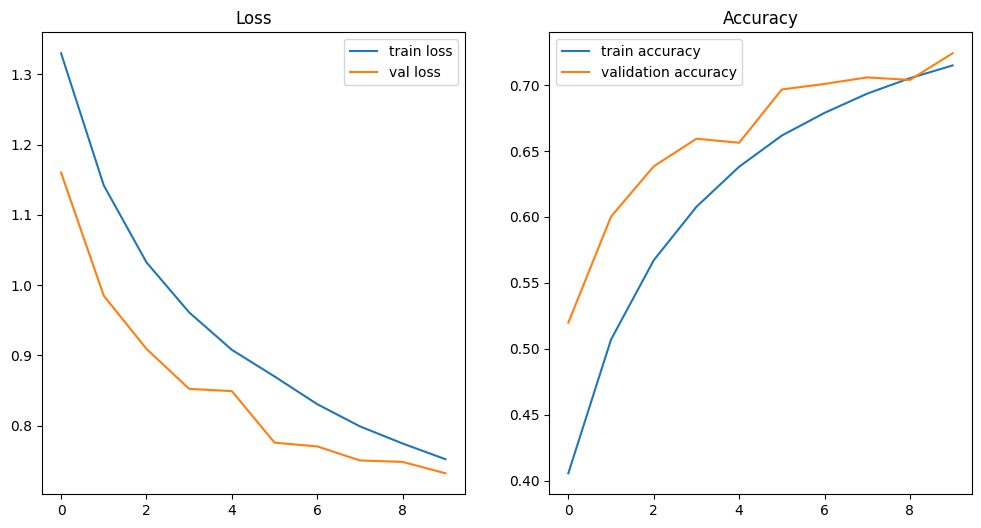

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

1/1 [==============================] - 0s 326ms/step


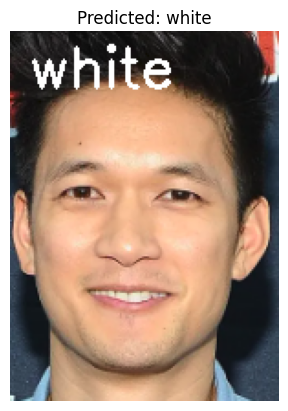

1/1 [==============================] - 0s 19ms/step


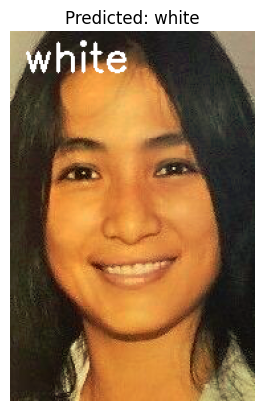

1/1 [==============================] - 0s 18ms/step


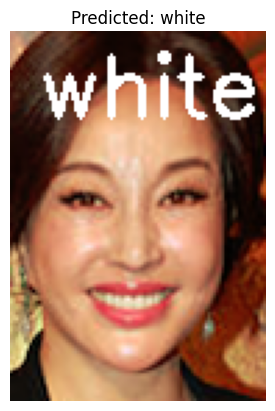

1/1 [==============================] - 0s 18ms/step


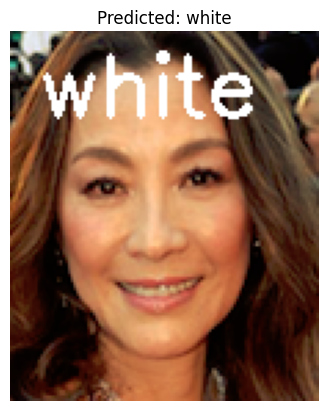

1/1 [==============================] - 0s 18ms/step


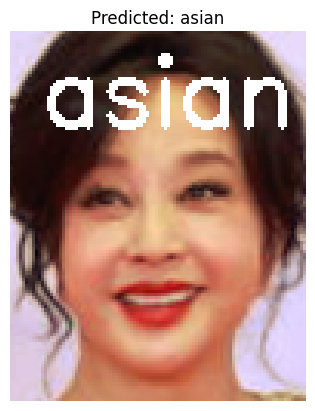

1/1 [==============================] - 0s 18ms/step


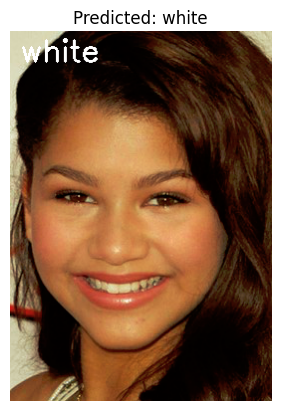

1/1 [==============================] - 0s 30ms/step


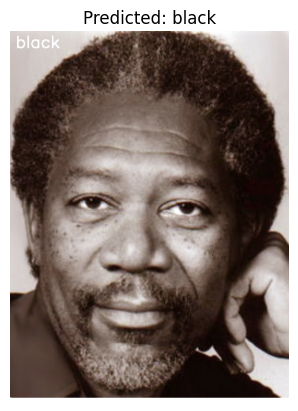

1/1 [==============================] - 0s 19ms/step


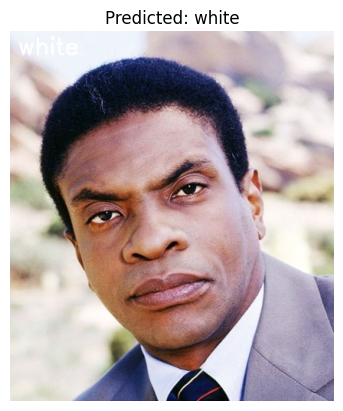

1/1 [==============================] - 0s 29ms/step


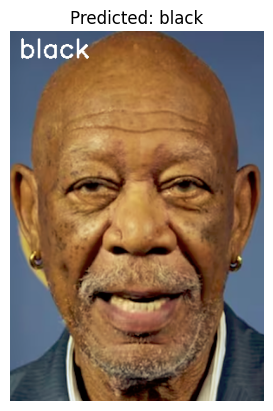

1/1 [==============================] - 0s 19ms/step


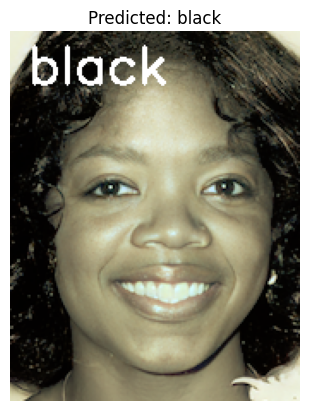

1/1 [==============================] - 0s 19ms/step


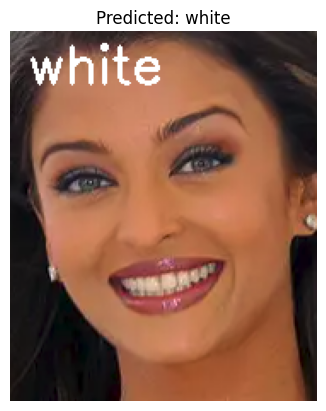

1/1 [==============================] - 0s 29ms/step


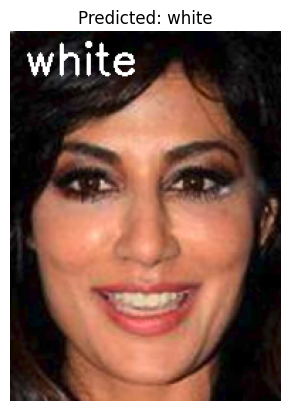

1/1 [==============================] - 0s 28ms/step


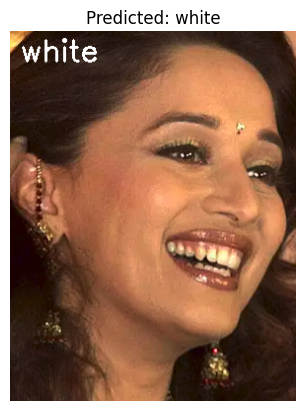

1/1 [==============================] - 0s 28ms/step


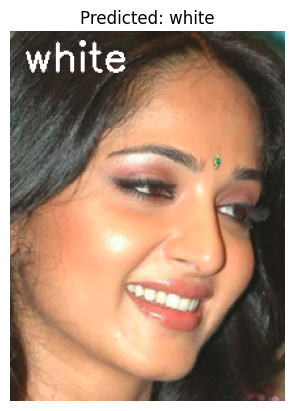

1/1 [==============================] - 0s 28ms/step


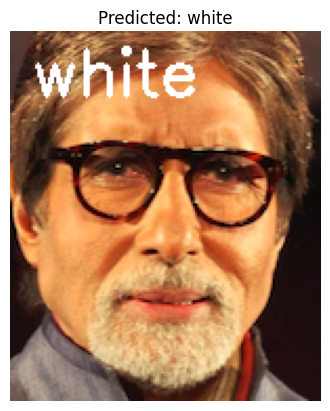

1/1 [==============================] - 0s 25ms/step


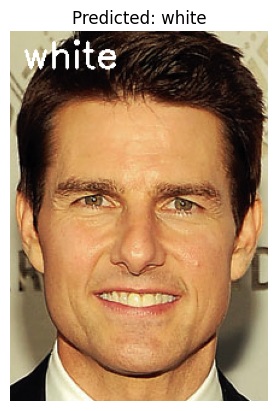

1/1 [==============================] - 0s 35ms/step


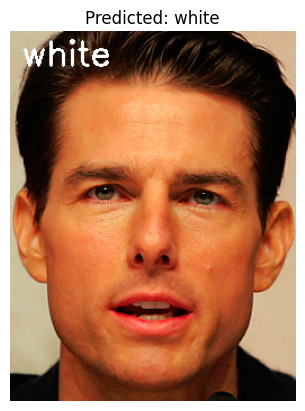

1/1 [==============================] - 0s 35ms/step


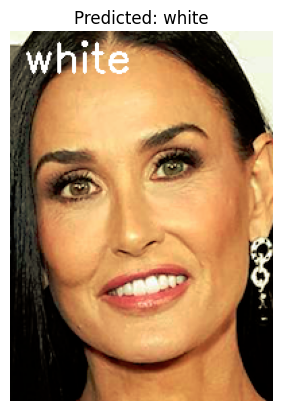

1/1 [==============================] - 0s 50ms/step


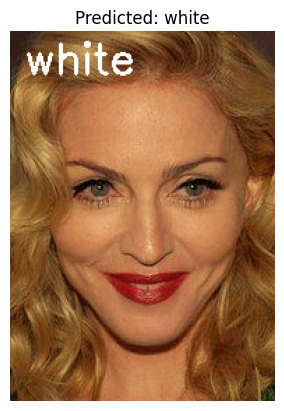

1/1 [==============================] - 0s 21ms/step


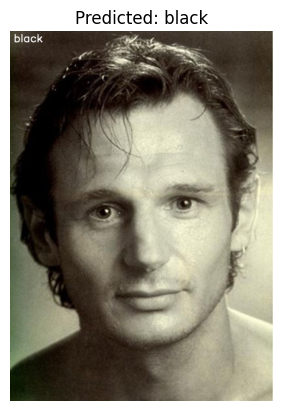

In [ ]:
##  sam prediction

def predict_on_image(image_path, model):
    img = cv2.imread(image_path)
    if img is None:
        raise Exception(f"Failed to load the image at {image_path}. Check file format.")
    img = cv2.resize(img, (128, 128))  # Resize to the expected input size of the model
    img = img.astype('float32') / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)  # Add batch dimension

    predictions = model.predict(img)
    predicted_class_index = np.argmax(predictions, axis=1)[0]
    return categories[predicted_class_index]  # Return the predicted category


import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random

new_sample_dir = "/content/test_dataset/specific_dataset"
categories = ['asian', 'black', 'indian', 'white']

for category in categories:
    category_path = os.path.join(new_sample_dir, category)
    if os.path.isdir(category_path):
        image_files = [f for f in os.listdir(category_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        selected_files = random.sample(image_files, min(5, len(image_files)))
        for image_file in selected_files:
            image_path = os.path.join(category_path, image_file)
            try:
                predicted_race_class = predict_on_image(image_path, model)
                img_bgr = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
                cv2.putText(img_rgb, predicted_race_class, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

                plt.imshow(img_rgb)
                plt.title(f"Predicted: {predicted_race_class}")
                plt.axis('off')
                plt.show()
            except Exception as e:
                print(f"Error processing {image_path}: {str(e)}")

In [ ]:
## one more time trying the best model
## and it is without data augmentation
# with 5 epochs

In [ ]:
# Instead of freezing all the layers of the pre-trained VGG19 model, you can try fine-tuning some of the later layers.
# This allows the model to adapt and learn more specific features from your dataset

from tensorflow.keras import models
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model


# Load the pre-trained VGG19 model
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

for layer in base_model.layers[-4:]:
    layer.trainable = True


# Add a global spatial average pooling layer
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Add a fully-connected layer
x = Dense(1024, activation='relu')(x)

# Add another fully-connected layer
x = Dense(512, activation='relu')(x)

# Add another fully-connected layer with 256 units and 'sigmoid' activation
x = Dense(256, activation='relu')(x)


# Add a logistic layer with softmax activation for classification
predictions = Dense(num_classes, activation='softmax')(x)

# Define the model
model = Model(inputs=base_model.input, outputs=predictions)


# Compile the model
model.compile(optimizer=optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
result = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=5,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)


# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)


# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Get the evaluation metrics
evaluation = model.evaluate(test_generator)
print("Test Accuracy:", evaluation[1])
print("Test Loss:", evaluation[0])


Epoch 1/5
330/330 [==============================] - 67s 193ms/step - loss: 1.1999 - accuracy: 0.4859 - val_loss: 0.9058 - val_accuracy: 0.6143
Epoch 2/5
330/330 [==============================] - 62s 187ms/step - loss: 0.7426 - accuracy: 0.7205 - val_loss: 0.4994 - val_accuracy: 0.8121
Epoch 3/5
330/330 [==============================] - 62s 189ms/step - loss: 0.5473 - accuracy: 0.8051 - val_loss: 0.5737 - val_accuracy: 0.7919
Epoch 4/5
330/330 [==============================] - 63s 192ms/step - loss: 0.4435 - accuracy: 0.8468 - val_loss: 0.4994 - val_accuracy: 0.8148
Epoch 5/5
83/83 [==============================] - 4s 53ms/step - loss: 0.4177 - accuracy: 0.8483
Validation Loss: 0.4176526963710785
Validation Accuracy: 0.8482784628868103
Found 241 images belonging to 4 classes.
8/8 [==============================] - 1s 169ms/step - loss: 0.7620 - accuracy: 0.7054
Test Accuracy: 0.7053942084312439
Test Loss: 0.7620168328285217


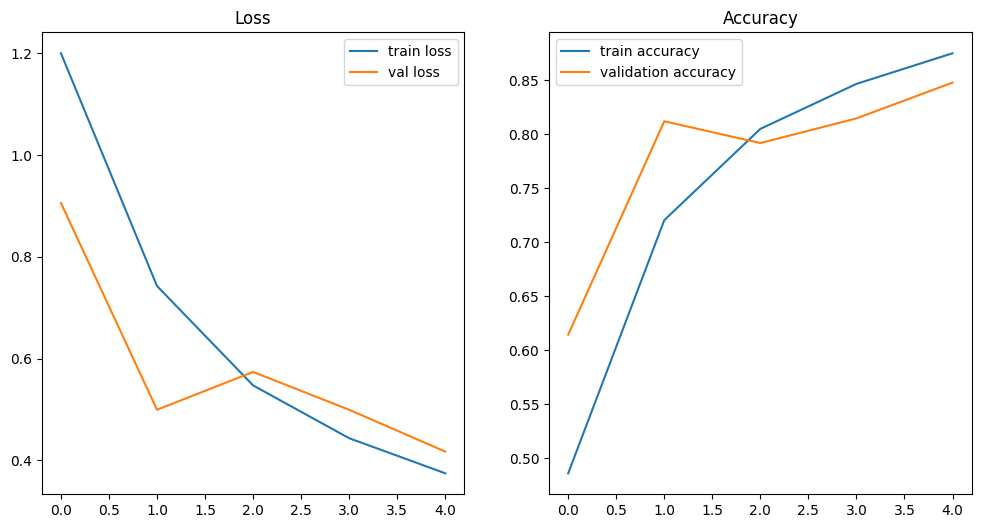

In [ ]:
# Plotting the training results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='train loss')
plt.plot(result.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='train accuracy')
plt.plot(result.history['val_accuracy'], label='validation accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()